# Imports

In [3545]:
import sys
import numpy as np
from scipy.io import loadmat
import matplotlib.pyplot as plt
from netCDF4 import Dataset
import xarray as xr
import seaborn as sns
import matplotlib
import seaborn as sns
import matplotlib.lines as mlines
import matplotlib
import os
from cmath import sqrt
import matplotlib.gridspec as gs
from fractions import Fraction
from PIL import ImageColor

sys.path.insert(0, '/home/disk/eos7/sressel/research/thesis-work/python/auxiliary_functions/')
from ipynb.fs.full.modified_colormap import Ahmed21_colormap
from ipynb.fs.full.bmh_colors import bmh_colors
Ahmed_cmap = Ahmed21_colormap()

# Move files to correct location

In [3801]:
new_files = glob.glob("./**/*/cp=*", recursive=True)
if not new_files:
    print("No files to move")

else:
    for file in new_files:
        model_type = file.split('model=')[-1].split('_vars')[0]
        print(f"File of model type {model_type}")
        experiment = file.split("/cp=")[0].split(f'model_{model_type}/')[-1]
        print(f"Moving to experiment directory: {experiment}")
        new_directory = f"{experiment}/{experiment}_cp={file.split('/cp=')[-1].split('_vars')[0]}"
        print(f"New directory name: {new_directory}")
        if not os.path.exists(f"./model_{model_type}/{new_directory}/"):
            os.mkdir(f"./model_{model_type}/{new_directory}/")
            print("Creating directory")
        else:
            print("Directory exists")

        print(f"Moving file {file}")
        os.system(f"mv {file} ./model_{model_type}/{new_directory}/vars_2D.nc")
        print("")

No files to move


# Find specific experiments

In [3897]:
new_files = sorted(glob.glob("./model_A/*epsq=0.333*/*k=2*", recursive=True))
for file in new_files[::-1]:
    print(file)

./model_A/meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=1.000/meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=1.000_cp=6.80_k=2.00_model=A
./model_A/meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.800/meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.800_cp=7.60_k=2.00_model=A
./model_A/meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.600/meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.600_cp=8.70_k=2.00_model=A
./model_A/meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.500/meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.500_cp=9.40_k=2.00_model=A
./model_A/meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.400/meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.400_cp=10.00_k=2.00_model=A
./model_A/meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.200/meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.200_cp=13.00_k=2.00_model=A
./model_A/meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.000/meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.000_cp=16.00_k=2.00_model=A


# Specify experiments to load

In [4960]:
## specify list of experiments. For starters there is just one
# experiments=['meridMode=1_equivalentDepth=12_waveType=Kelvin']
experiments = [
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=7.70_k=1.00_model=A',      # Default A21
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=8.50_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=9.60_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=11.00_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.100_cp=14.00_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.050_cp=15.00_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.000_cp=18.00_k=1.00_model=A',

    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=1.000_cp=7.80_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.800_cp=8.70_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.600_cp=9.80_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.400_cp=11.00_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.200_cp=14.00_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.000_cp=18.00_k=1.00_model=A',
    
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=1.000_cp=7.80_k=1.00_model=A',   
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=7.70_k=1.00_model=A',      # Default A21
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.083_epst=0.250_cp=7.50_k=1.00_model=A',   
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.083_epst=0.200_cp=8.50_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.083_epst=0.125_cp=9.60_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.083_epst=0.083_cp=11.00_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.083_epst=0.050_cp=14.00_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.083_epst=0.042_cp=14.00_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.083_epst=0.000_cp=18.00_k=1.00_model=A',

    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=7.70_k=1.00_roll_test_model=A',
    
    'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.70_k=2.00_model=A',
    'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=7.50_k=2.00_model=A',
    'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=8.60_k=2.00_model=A',
    'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=10.00_k=2.00_model=A',
    'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.100_cp=13.00_k=2.00_model=A',
    'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.000_cp=16.00_k=2.00_model=A',

    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=1.000_cp=6.80_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.800_cp=7.60_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.600_cp=8.70_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.500_cp=9.40_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.400_cp=10.00_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.200_cp=13.00_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.000_cp=16.00_k=2.00_model=A',

    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.167_cp=11.00_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.028_cp=16.00_k=2.00_model=A',

    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.60_k=3.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=7.40_k=3.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=8.60_k=3.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=10.00_k=3.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.100_cp=14.00_k=3.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.000_cp=6.80_k=3.00_model=A',

    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=1.000_cp=6.60_k=3.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.800_cp=7.40_k=3.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.600_cp=8.50_k=3.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.500_cp=9.20_k=3.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.400_cp=10.00_k=3.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.200_cp=12.00_k=3.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.000_cp=16.00_k=3.00_model=A',
    
    
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_a=0.001_cp=6.70_k=2.00_model=H',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_a=0.014_cp=6.60_k=2.00_model=H',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.028_a=0.014_cp=8.40_k=2.00_model=H',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.028_cp=16.00_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.042_epst=0.001_a=0.004_cp=26.00_k=1.00_model=J',
    # 'meff=0.10_xiy=1.00_xix=-1.00_epsq=0.042_epst=0.001_a=0.004_cp=1.40_k=1.00_model=J',
    # 'meff=0.10_xiy=0_xix=-1.00_epsq=0.042_epst=0.001_a=0.004_cp=2.00_k=2.00_model=J',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_a=0.000_cp=5.20_k=2.00_model=J',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_a=0.001_cp=5.20_k=2.00_model=J',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_a=0.004_cp=5.20_k=2.00_model=J',
    
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.028_cp=23.00_k=2.70_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.028_cp=9.90_k=2.70_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=7.70_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=1.000_cp=6.80_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.083_epst=0.250_cp=6.60_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.333_epst=0.500_cp=9.40_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.250_cp=9.40_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.083_epst=0.125_cp=9.70_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.083_epst=0.083_cp=12.00_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.083_epst=0.042_cp=14.00_k=1.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.083_epst=0.000_cp=5.40_k=2.00_model=A'
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=7.50_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=8.60_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=10.00_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.100_cp=13.00_k=2.00_model=A'
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.000_cp=16.00_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.167_cp=11.00_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.028_cp=16.00_k=2.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.70_k=2.00_variable-r_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.693_cp=7.20_k=2.00_variable-r_variable-epst_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.342_cp=11.00_k=2.00_variable-r_variable-epst_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.196_cp=16.00_k=2.00_variable-r_variable-epst_model=A',
    # 'meff=0.10_xiy=0.03_xix=-0.00_epsq=0.042_epst=0.001_cp=1.10_k=2.00_model=WS22',
    # 'meff=0.10_xiy=0.33_xix=-0.00_epsq=0.042_epst=0.001_cp=4.40_k=2.00_model=WS22',
    # 'meff=0.10_xiy=1_xix=-0.00_epsq=0.042_epst=0.001_cp=8.90_k=2.00_model=WS22',
    # 'meff=0.10_xiy=0.002_xix=-0.002_epsq=0.083_epst=0.001_a=0.000_cp=-34.00_k=2.00_model=WS22',
    # 'meff=0.10_xiy=0.001_xix=0.002_epsq=0.042_epst=0.001_a=0.000_cp=14.00_k=2.00_model=WS22',
    # 'meff=0.10_xiy=0.001_xix=0.001_epsq=0.083_epst=0.003_a=0.008_cp=14.00_k=2.00_model=WS22',
    # 'meff=0.10_xiy=0.001_xix=0.001_epsq=0.021_epst=0.001_a=0.002_cp=5.00_k=2.00_model=WS22',
    # 'meff=0.10_xiy=0.001_xix=0.001_epsq=0.042_epst=0.001_a=0.004_cp=8.80_k=2.00_model=WS22',
    # 'meff=0.10_xiy=0.001_xix=0.001_epsq=0.042_epst=0.001_a=0.000_cp=8.50_k=2.00_model=WS22',
    # 'meff=0.10_xiy=0.000_xix=0.002_epsq=0.083_epst=0.001_a=0.008_cp=22.00_k=2.00_model=WS22',
    # 'meff=0.10_xiy=0.000_xix=0.002_epsq=0.167_epst=0.001_a=0.008_cp=31.00_k=2.00_model=WS22',
    # 'meff=0.10_xiy=0.000_xix=0.002_epsq=0.167_epst=0.004_a=0.014_cp=31.00_k=2.00_model=WS22',
    
    # 'meff=0.10_xiy=0.000_xix=0.002_epsq=0.042_epst=0.004_a=0.014_cp=15.00_k=2.00_model=WS22',
    # 'meff=0.10_xiy=-1_xix=0.002_epsq=0.042_epst=0.004_a=0.014_cp=12.00_k=2.00_model=WS22',
    
    # 'meff=0.10_xiy=0.001_xix=0.001_epsq=0.083_epst=0.003_cp=14.00_k=2.00_model=WS22',
    # 'meff=0.10_xiy=0.001_xix=0.001_epsq=0.083_epst=0.001_cp=13.00_k=2.00_model=WS22',
    # 'meff=0.10_xiy=0.001_xix=0.002_epsq=0.083_epst=0.001_a=0.004_cp=22.00_k=2.00_model=WS22'
    # 'meff=0.10_xiy=1_xix=0.00_epsq=0.042_epst=0.001_cp=21.00_k=2.00_model=WS22',
    
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.000_cp=10.00_k=2.00_model=D',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.073_epst=0.000_cp=3.90_k=2.00_model=D',
    
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=200.00_k=2.00_model=WS22',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=-0.167_epst=0.500_cp=-190.00_k=2.00_model=WS22'
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.60_k=3.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.60_k=4.00_model=A',
    # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.70_k=5.00_model=A',
]

## specify input directory
dir_in=r'/home/disk/eos7/sressel/research/thesis-work/python/recreating_Ahmed21'

# Routine to read dispersion properties

In [4961]:
#define constants
delpg=800*1e2/9.8
Lv=2260e3
cp=1006.

def read_files(exp_name):

    print(exp_name)
    model_type[exp_name] = exp_name.split("_model=")[-1]
    fname1p = f"{dir_in}/model_{model_type[exp_name]}/{exp_name.split('_cp=')[0]}/t1_plus.mat"
    fname1m = f"{dir_in}/model_{model_type[exp_name]}/{exp_name.split('_cp=')[0]}/t1_minus.mat"
    fname2 = f"{dir_in}/model_{model_type[exp_name]}/{exp_name.split('_cp=')[0]}/params.mat"
    fname3 = f"{dir_in}/model_{model_type[exp_name]}/{exp_name.split('_cp=')[0]}/klist.mat"
    fname4 = f"{dir_in}/model_{model_type[exp_name]}/{exp_name.split('_cp=')[0]}/{exp_name}/vars_2D.nc"
    
    # # fname1p=dir_in+exp_name+'/t1_plus.mat'
    # # fname1m=dir_in+exp_name+'/t1_minus.mat'
    # # fname2=dir_in+exp_name+'/params.mat'
    # # fname3=dir_in+exp_name+'/klist.mat'
    # # fname4=dir_in+exp_name+'/vars_2D.nc'

    #extract phase speed
    phase_speed[exp_name]=float(exp_name.split('cp=')[-1].split('_')[0])
    solution_k[exp_name] = float(exp_name.split('k=')[-1].split('_')[0])

    # #read params
    data2=loadmat(fname2)
    # print(fname2)
    epsq[exp_name] = data2['epsq'][0].squeeze()
    if (model_type[exp_name] == "A") or (model_type[exp_name] == "H"):
        epsa[exp_name] = data2['epsa'][0].squeeze()
    epst[exp_name] = data2['epst'][0].squeeze()
    if (model_type[exp_name] == 'WS22') or (model_type[exp_name] == 'H') or (model_type[exp_name] == 'J'):
        alpha[exp_name] = data2['a'][0].squeeze()
    r[exp_name] = data2['r'][0].squeeze()
    meff[exp_name] = data2['meff'][0].squeeze()
    c[exp_name] = data2['c'][0].squeeze()
    beta[exp_name] = data2['beta'][0].squeeze()
    sigma_x[exp_name] = data2['sigma_x'][0].squeeze()
    sigma_y[exp_name] = data2['sigma_y'][0].squeeze()
    Ms[exp_name] = data2['Ms'][0].squeeze()
    Re[exp_name] = data2['Re'][0].squeeze()

    #read wavenumber
    data3=loadmat(fname3)['Expression1']
    klist_read=np.squeeze(np.concatenate((-data3[::-1],data3)))
    
    #compute m using meff and r
    m=(meff[exp_name]+r[exp_name])/(1+r[exp_name])
    
    ## Load eigenvalues from the 'plus' solutions###
    
    data1p=loadmat(fname1p)['Expression1'].astype('complex128')   
    data1p[data1p == 1e10] = np.nan
    ## Make mirror image of solution along k axis and join ###
    ### Warning: imaginary portion of np.nan gives zero, so setting both real and imag. portions explicitly to zero
    data1p_joined=np.concatenate((data1p[::-1,:],data1p),axis=0)
    data1p_joined[np.isnan(data1p_joined)]=np.nan+1J*np.nan

    data_speed_readp=-data1p_joined.imag*Re[exp_name]/(3600.*klist_read[:,None])
    disp_freq_readp=-data1p_joined.imag # frequency 
    disp_growth_readp=data1p_joined.real # growth rates
    
    disp_freq_readp[data_speed_readp<0]=np.nan
    disp_freq_readp[disp_freq_readp<0]=-disp_freq_readp[disp_freq_readp<0]
    disp_growth_readp[data_speed_readp<0]=np.nan
    disp_growthp[exp_name]=disp_growth_readp
    disp_freqp[exp_name]=disp_freq_readp
    
    ## Load eigenvalues from the 'minus' solutions###
    data1m=loadmat(fname1m)['Expression1'].astype('complex128')
    data1m[data1m == 1e10] = np.nan
    data1m_joined=np.concatenate((data1m[::-1,:],data1m),axis=0).astype(complex)
    data1m_joined[np.isnan(data1m_joined)]=np.nan+1J*np.nan

    data_speed_readm=-data1m_joined.imag*Re[exp_name]/(3600.*klist_read[:,None])
    disp_freq_readm=-data1m_joined.imag
    disp_growth_readm=data1m_joined.real
     
    disp_freq_readm[data_speed_readm<0]=np.nan
    disp_freq_readm[disp_freq_readm<0]=-disp_freq_readm[disp_freq_readm<0]
    disp_growth_readm[data_speed_readm<0]=np.nan     
    disp_growthm[exp_name]=disp_growth_readm
    disp_freqm[exp_name]=disp_freq_readm
        
    ## read wavenumbers
    klist[exp_name]=klist_read
    
    # read the eigenfunctions
    # f=Dataset(fname4,'r')
    f = xr.open_dataset(fname4)
    x[exp_name],y[exp_name]=np.squeeze(f.variables['x']),np.squeeze(f.variables['y'])
    u[exp_name]=np.squeeze(f.variables['u'])
    v[exp_name]=np.squeeze(f.variables['v'])
    omega[exp_name]=np.squeeze(f.variables['omega'])
    
    That[exp_name]=np.squeeze(f.variables['That'])/delpg ## convert to K
    qhat[exp_name]=np.squeeze(f.variables['qhat'])/delpg ## convert to K

    h[exp_name] = np.squeeze(f.variables['h'])/delpg ## convert to K
    h_tendency[exp_name] = np.squeeze(f.variables['htend'])*3600/delpg ## convert to K/hr

    pcp[exp_name]=np.squeeze(f.variables['precip'])*3600./delpg ### convert to K/hr
    gamma_qT[exp_name]=qhat[exp_name].max()/That[exp_name].max()
                
    f.close()
    
    return c,beta,Ms,Re
    

# Load dispersion curves

In [4962]:
### declare dicts 
model_type={}
epsq={}
epsa={}
epst={}
alpha={}
meff={}
r = {}
sigma_x={}
sigma_y={}
Re={}
Ms = {}
phase_speed={}
c={}
beta={}
solution_k = {}

disp_growthp={}
disp_freqp={}

disp_growthm={}
disp_freqm={}

klist={}

u={}
v={}
omega={}
That={}
qhat={}
pcp={}
x={}
y={}
gamma_qT={}
h={}
h_tendency={}

### read files ###

for i in experiments:
    # print(i)
    # c,beta,Ms,Re=read_files(i)
    read_files(i)

# epst={}
# for i in experiments:
#     epst[i] = (epsa[i] - epsq[i])/(1+r)

meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.70_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=7.50_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=8.60_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=10.00_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.100_cp=13.00_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.000_cp=16.00_k=2.00_model=A


# Specify colors

### Specify the colors from colormap

In [4963]:
# colors = {}
# colors[experiments[0]] = bmh_colors(1)
# print(0, experiments[0])
# for index, exp in enumerate(experiments[1:]):
#     print(index+1, exp)
#     colors[experiments[index+1]] = bmh_colors(index+2)

experiments_to_color = experiments
# experiments_to_color = experiments[:6]
# experiments_to_color = experiments[6:]

colors = {}
colors[experiments[0]] = 'orange'
# colors[experiments[6]] = 'orange'
print(0, experiments[0])
# for index, exp in enumerate(experiments[1:6]):
# for index, exp in enumerate(experiments[7:]):
for index, exp in enumerate(experiments[1:]):
    print(index+1, exp)
    colors[exp] = plt.cm.viridis_r(np.linspace(0, 1, len(experiments_to_color)))[index]

0 meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.70_k=2.00_model=A
1 meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=7.50_k=2.00_model=A
2 meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=8.60_k=2.00_model=A
3 meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=10.00_k=2.00_model=A
4 meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.100_cp=13.00_k=2.00_model=A
5 meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.000_cp=16.00_k=2.00_model=A


In [3936]:
colors

{'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=7.70_k=1.00_model=A': 'orange',
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=8.50_k=1.00_model=A': array([0.993248, 0.906157, 0.143936, 1.      ]),
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=9.60_k=1.00_model=A': array([0.477504, 0.821444, 0.318195, 1.      ]),
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=11.00_k=1.00_model=A': array([0.134692, 0.658636, 0.517649, 1.      ]),
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.100_cp=14.00_k=1.00_model=A': array([0.163625, 0.471133, 0.558148, 1.      ]),
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.000_cp=18.00_k=1.00_model=A': array([0.253935, 0.265254, 0.529983, 1.      ])}

### Specify colors individually

In [3776]:
# colors[experiments[-1]] = 'maroon'
# colors[experiments[-2]] = 'maroon'
# colors = {}
colors[experiments[3]] = '#47E5BC'
colors[experiments[4]] = '#81E4DA'
colors[experiments[5]] = '#9F9FAD'
# colors[experiments[2]] = 'green'

colors[experiments[0]] = '#710000'
colors[experiments[1]] = '#C36F09'
colors[experiments[2]] = '#EEBA0B'


# Load Matsuno

## Routine to read Matsuno data

In [4180]:
def load_matsuno(exp_name):

    dir_in=r'/home/disk/eos7/sressel/research/thesis-work/python/recreating_Ahmed21/'
    frequencies = loadmat(f"{dir_in}/{exp_name}/freq_{exp_name}.mat")["Expression1"]
    klist = loadmat(f"{dir_in}/{exp_name}/klist_{exp_name}.mat")["Expression1"]

    equivalent_depth[exp_name] = float(
        exp_name.split("equivalentDepth=")[-1].split("_")[0]
    )

    wave_type[exp_name] = exp_name.split("waveType=")[-1]

    frequencies_joined = np.concatenate((frequencies[::-1, :], frequencies), axis=0)
    klist_joined = np.squeeze(np.concatenate((-klist[::-1], klist)))
    phase_speed = -frequencies_joined / klist_joined[:, None]

    frequencies_joined[phase_speed < 0] = np.nan
    frequencies_joined[frequencies_joined < 0] = -frequencies_joined[
        frequencies_joined < 0
    ]
    matsuno_frequencies[exp_name] = frequencies_joined
    matsuno_klist[exp_name] = klist_joined

    # fname4 = f"{dir_in}/{exp_name}/vars_2D_{exp_name}.nc"
    # f = Dataset(fname4, "r")
    # x_mats[exp_name] = np.squeeze(f.variables["x"][:])
    # y_mats[exp_name] = np.squeeze(f.variables["y"][:])
    # u_mats[exp_name] = np.squeeze(f.variables["u"][:])
    # v_mats[exp_name] = np.squeeze(f.variables["v"][:])
    # phi_mats[exp_name] = np.squeeze(f.variables["phi"][:])

    # f.close()


matsuno_frequencies = {}
matsuno_klist = {}
equivalent_depth = {}
wave_type = {}

x_mats = {}
y_mats = {}
u_mats = {}
v_mats = {}
phi_mats = {}

matsuno_experiments = [
    "waveType=1_meridMode=1_k=1.00_equivalentDepth=4_waveType=Kelvin",
    "waveType=1_meridMode=1_k=1.00_equivalentDepth=4_waveType=Rossby",
]

for i in matsuno_experiments:
    load_matsuno(i)

## Load in Matsuno data

In [3005]:
# matsuno_klist_file = f"{dir_in}/m=0_H=4_cp=73.400_k=1.00_model=matsuno/klist.mat"
# matsuno_t1plus_file = f"{dir_in}/m=0_H=4_cp=73.400_k=1.00_model=matsuno/t1_plus.mat"
# matsuno_data = loadmat(matsuno_t1plus_file)

# matsuno_frequency = matsuno_data['Expression1']
# matsuno_frequency[matsuno_frequency == 1e10] = np.nan
# ## Make mirror image of solution along k axis and join ###
# ### Warning: imaginary portion of np.nan gives zero, so setting both real and imag. portions explicitly to zero
# matsuno_frequency_joined=np.concatenate((matsuno_frequency[::-1,:],matsuno_frequency),axis=0)
# matsuno_frequency_joined[np.isnan(matsuno_frequency_joined)]=np.nan

# matsuno_klist = loadmat(matsuno_klist_file)['Expression1']
# matsuno_klist_read = np.squeeze(np.concatenate((-matsuno_klist[::-1],matsuno_klist)))

# data_speed_readp=matsuno_frequency_joined.real*Re/(3600.*matsuno_klist_read[:,None])
# disp_freq_readp=matsuno_frequency_joined.real # frequency 
# # disp_growth_readp=matsuno_frequency_joined.imag # growth rates

# disp_freq_readp[data_speed_readp<0]=np.nan
# disp_freq_readp[disp_freq_readp<0]=-disp_freq_readp[disp_freq_readp<0]
# # disp_growth_readp[data_speed_readp<0]=np.nan
# # disp_growthp['matsuno']=disp_growth_readp
# disp_freqp['matsuno']=disp_freq_readp

# Plot the dispersion relationships (Fig. 2 in Ahmed 2021)

## Plot A21 style view

In [3654]:
# ln={
#     'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.70_k=2.00_model=A' : 'Ahmed21',
#     # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=7.50_k=2.00_model=A' : r'ε_$t$=0.4',
#     # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=8.60_k=2.00_model=A' : r'ε_$t$=0.3',
#     # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=10.00_k=2.00_model=A' : r'ε_$t$=0.2',
#     # 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.100_cp=13.00_k=2.00_model=A' : r'ε_$t$=0.1',
# }

# plt.style.use('bmh')
# fig,axx=plt.subplots(2,2,figsize=(12,7))

# for no,exp_name in enumerate(experiments):

#     ax=axx[0,0]
#     # Dry Matsuno Solutions
#     for mats_no, mats_exp in enumerate(matsuno_experiments):
#         wavenumber = matsuno_klist[mats_exp]
#         frequency = matsuno_frequencies[mats_exp]
#         H = equivalent_depth[mats_exp]
    
#         for i in range(frequency.shape[1]):
#             ax.scatter(
#                 -Re[exp_name] * wavenumber,
#                 frequency[:, i] * 24,
#                 s=5,
#                 c='darkgray',
#                 alpha=1,
#             )

#     for i in range(disp_freqp[exp_name].shape[1]):
#         freqp=np.copy(disp_freqp[exp_name][:,i])
#         grp=np.copy(disp_growthp[exp_name][:,i])
#         speed=freqp*Re[exp_name]/(3600.0*klist[exp_name])
#         ax.scatter(klist[exp_name],freqp*24,s=5,c=colors[exp_name],alpha=0.5)
#         freqm=np.copy(disp_freqm[exp_name][:,i])

#         ax.scatter(klist[exp_name],freqm*24,s=5,c=colors[exp_name],alpha=0.5)
    

#         if no==0:
#             ln[exp_name] = mlines.Line2D([], [], color=colors[exp_name], linestyle='-', markersize=10, 
#                                          label='Ref.')
            
            
#     ax.vlines(0,0.5*24,-0.9,linestyle='--',zorder=-1,color='black')
    
#     if no==0:
#         ax.text(0.05,0.7,'WIG',transform=ax.transAxes,fontsize=14)
#         ax.text(0.82,0.7,'EIG',transform=ax.transAxes,fontsize=14)
#         ax.text(0.35,0.125,'WRW',transform=ax.transAxes,fontsize=14)
#         ax.text(0.55,0.125,'ERW',transform=ax.transAxes,fontsize=14)

#     ax.tick_params(which='both',labelsize=13)
#     ax.set_title('(a) Frequency for n=1 modes',fontsize=15)
#     ax.set_ylim(bottom=0.0,top=10)
#     ax.set_xlim(-15,15.)
#     ax.set_ylabel('$\mathrm{day}^{-1}$',fontsize=16)
    
            
#     ax=axx[1,0]
#     # Dry Matsuno Solutions
#     for mats_no, mats_exp in enumerate(matsuno_experiments):
#         wavenumber = matsuno_klist[mats_exp]
#         frequency = matsuno_frequencies[mats_exp]
#         H = equivalent_depth[mats_exp]
    
#         for i in range(frequency.shape[1]):
#             ax.scatter(
#                 -Re[exp_name] * wavenumber,
#                 frequency[:, i] * 24,
#                 s=5,
#                 c='darkgray',
#                 alpha=1,
#             )
    
#     for i in range(disp_freqp[exp_name].shape[1]):
#         freqp=np.copy(disp_freqp[exp_name][:,i])
#         grp=np.copy(disp_growthp[exp_name][:,i])
#         speed=freqp*Re[exp_name]/(3600.0*klist[exp_name])
#         ax.scatter(klist[exp_name],freqp*24,s=5,c=colors[exp_name],alpha=0.5)
        
#         freqm=np.copy(disp_freqm[exp_name][:,i])
#         speed=freqm*Re[exp_name]/(3600.0*klist[exp_name])
#         ax.scatter(klist[exp_name],freqm*24,s=5,c=colors[exp_name],alpha=0.5)
    

#         if no==0:
#             ln[exp_name] = mlines.Line2D([], [], color=colors[exp_name], linestyle='-', markersize=10, 
#                                          label='Ref.')

#     ax.set_yticks(ticks = np.arange(0, 1, 0.2), labels=np.round(np.arange(0,1,0.2)/(2*np.pi), 3))
#     ax.axhline(y=2*np.pi/90, color='darkgray', alpha=0.75, ls='--')
#     ax.text(14.9, (2*np.pi/90+0.01), '90 days', ha='right', color='gray', fontsize=12)
#     ax.axhline(y=2*np.pi/30, color='darkgray', alpha=0.75, ls='--')
#     ax.text(14.9, (2*np.pi/30+0.01), '30 days', ha='right', color='gray', fontsize=12)
#     ax.axhline(y=2*np.pi/10, color='darkgray', alpha=0.75, ls='--')
#     ax.text(14.9, (2*np.pi/10+0.01), '10 days', ha='right', color='gray', fontsize=12)
                
        
#     ax.vlines(0,0.5*24,-0.9,linestyle='--',zorder=-1,color='black')
#     if no==0:
#         ax.text(0.325,0.25,'WRW',transform=ax.transAxes,fontsize=14)
#         ax.text(0.65,0.25,'ERW',transform=ax.transAxes,fontsize=14)

#     ax.tick_params(which='both',labelsize=13)
#     ax.set_title('(c) Frequency for n=1 modes',fontsize=15)
#     ax.set_ylim(bottom=0.0,top=0.9)
#     ax.set_xlim(-15,15.)
#     ax.set_xlabel('Zonal wavenumber',fontsize=15)
#     ax.set_ylabel('$\mathrm{day}^{-1}$',fontsize=16)    
    
#     ax=axx[0,1]
#     for i in range(disp_growthp[exp_name].shape[1]):
#         freqp=np.copy(disp_freqp[exp_name][:,i])
#         grp=np.copy(disp_growthp[exp_name][:,i])
#         speed=freqp/(klist[exp_name])
#         ax.scatter(klist[exp_name],grp*24,s=5,c=colors[exp_name],alpha=0.5)
#         ax.scatter(klist[exp_name],disp_growthm[exp_name][:,i]*24.,s=5,c=colors[exp_name],alpha=0.5)

#     ax.tick_params(which='both',labelsize=13)
#     ax.set_title('(b) Growth rates for n=1 modes',fontsize=15)
#     # ax.set_ylim(top=0.1,bottom=-2)
#     ax.set_ylim(top=0.6,bottom=-2)
#     ax.set_xlim(-15.,15.)
#     if no==0:
#         ax.text(0.25,0.3,'WIG',transform=ax.transAxes,fontsize=14)
#         ax.text(0.625,0.3,'EIG',transform=ax.transAxes,fontsize=14)
    
#     ax.vlines(0,0.5*24,-5.0,linestyle='--',zorder=-1,color='black')
    
#     ax=axx[1,1]
#     for i in range(disp_growthp[exp_name].shape[1]):
#         freqp=np.copy(disp_freqp[exp_name][:,i])
#         grp=np.copy(disp_growthp[exp_name][:,i])
#         speed=freqp/(klist[exp_name])
#         ax.scatter(klist[exp_name],grp*24,s=5,c=colors[exp_name],alpha=0.5)
#         ax.scatter(klist[exp_name],disp_growthm[exp_name][:,i]*24.,s=5,c=colors[exp_name],alpha=0.5)

#     ax.axhline(y=0, ls=':', color='gray')
#     # ax.set_yticks(ticks = np.arange(-0.1, 0.035, 0.025), labels=np.round(np.arange(-0.1, 0.035, 0.025)/(2*np.pi), 2))
    
#     if no==0:
#         ax.text(0.12,0.61,'WRW',transform=ax.transAxes,fontsize=14)
#         ax.text(0.7,0.125,'ERW',transform=ax.transAxes,fontsize=14)

#     ax.tick_params(which='both',labelsize=13)
#     ax.set_title('(d) Growth rates for n=1 modes',fontsize=15)
#     ax.set_ylim(top=0.0525,bottom=-0.1)
#     ax.set_xlim(-15.,15.)
#     ax.set_xlabel('Zonal wavenumber',fontsize=15)
    
#     ax.vlines(0,0.5*24,-5.0,linestyle='--',zorder=-5,color='black')    
#     plt.subplots_adjust(top=0.8)
    

# # leg_names=[]
# # leg_labels=[]
# # leg_names.append('Ahmed21')

# # for n,exp_name in enumerate(experiments):
# #     leg_names.append(ln[exp_name])
# #     leg_labels.append(exp_name)
    
# # leg=axx[0,0].legend(
# #     # handles=leg_names,
# #     labels=leg_names,
# #     ncol=1,
# #     fontsize=14.0,
# #     loc=(0.75,0.05)
# # )

# frame=leg.get_frame()
# frame.set_edgecolor('black')
# frame.set_facecolor('white')
# frame.set_alpha(1)

# plt.tight_layout()
# SAVE=False
# if SAVE:
#     plt.savefig('./Fig_wavenumber_frequency.pdf',
#                format='pdf',dpi=125,bbox_inches='tight')

## Plot only zoomed in frequency

/tmp/ipykernel_2563720/2025826065.py:62: RuntimeWarning: divide by zero encountered in scalar divide
  r"ε$_t$ = 1/" + f"{1/(3600*epst[exp_name]):0.1f}" + r" hr$^{-1}$ "


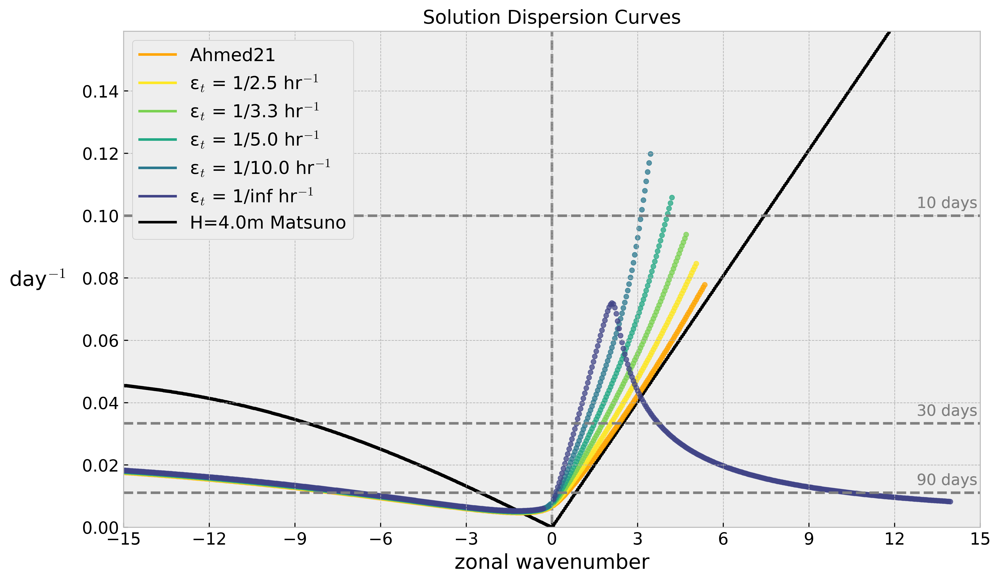

In [3655]:
plt.style.use('bmh')
fig,ax=plt.subplots(1,1,figsize=(12,7), dpi=500)
ax.set_title('Solution Dispersion Curves',fontsize=15)

ln = {}
# Dry Matsuno Solutions
for mats_no, mats_exp in enumerate(matsuno_experiments):
    wavenumber = matsuno_klist[mats_exp]
    frequency = matsuno_frequencies[mats_exp]
    H = equivalent_depth[mats_exp]

    for i in range(frequency.shape[1]):
        ax.scatter(
            -float(Re[experiments[0]]) * wavenumber,
            frequency[:, i] * 24/(2*np.pi),
            s=5,
            edgecolor='black',
            alpha=1,
            marker='o',
            facecolor='black'
        )

        ln[mats_exp] = mlines.Line2D(
            [], [], color='black', linestyle="-", label=f"H={H}m Matsuno"
        )

for no,exp_name in enumerate(experiments):
    for i in range(disp_freqp[exp_name].shape[1]):
        freqp=np.copy(disp_freqp[exp_name][:,i])
        ax.scatter(
            klist[exp_name],
            freqp * 24/(2*np.pi),
            s=15,
            edgecolor=colors[exp_name],
            facecolor=colors[exp_name],
            # facecolor='None',
            alpha=0.75,             
            marker='o',
        )
        freqm=np.copy(disp_freqm[exp_name][:,i])
        ax.scatter(
            klist[exp_name],
            freqm*24/(2*np.pi),
            s=15,
            edgecolor=colors[exp_name],
            facecolor=colors[exp_name],
            # facecolor='None',
            alpha=0.75,             
            marker='o',
        )

        if no == 0:
            ln[exp_name] = mlines.Line2D(
                [], [], color=colors[exp_name], linestyle="-", label='Ahmed21'
            )
        
        elif model_type[exp_name] == 'A':
            ln[exp_name] = mlines.Line2D(
                [], [], color=colors[exp_name], linestyle="-", 
                label=(
                    # r"ε$_q$ = 1/" + f"{1/(3600*epsq[exp_name]):0.1f}" + r" hr$^{-1}$, "
                    r"ε$_t$ = 1/" + f"{1/(3600*epst[exp_name]):0.1f}" + r" hr$^{-1}$ "
                    # + r"ε$_t$/ε$_q$ = " + f"{epst[exp_name]/epsq[exp_name]:0.1f}"
                )
            )
        
        elif model_type[exp_name] == 'D':
            ln[exp_name] = mlines.Line2D(
                [], [], color=colors[exp_name], linestyle="-", 
                label=r"WTG, ε$_q$ = 1/" + f"{1/(3600*epsq[exp_name]):0.1f}" + r" hr$^{-1}$"
            )

        elif model_type[exp_name] == 'WS22':
            ln[exp_name] = mlines.Line2D(
                [], [], color=colors[exp_name], linestyle="-", 
                label=(
                    r"WS22, ε$_q$ = 1/" + f"{1/(3600*epsq[exp_name]):0.1f}" + r" hr$^{-1}$ "
                    + r"ε$_t$ = 1/" + f"{1/(24*3600*epst[exp_name]):0.1f}" + r" day$^{-1}$ "
                    + r"α = 1/" + f"{1/(24*3600*alpha[exp_name]):0.1f}" + r" day$^{-1}$ "
                )
            )
        

        elif model_type[exp_name] == 'H':
            ln[exp_name] = mlines.Line2D(
                [], [], color=colors[exp_name], linestyle="-", 
                label=(
                    r"H, ε$_t$ = 1/" + f"{1/(3600*epst[exp_name]):0.1f}" + r" hr$^{-1}$, "
                    + r"α = 1/" + f"{1/(24*3600*alpha[exp_name]):0.1f}" + r" day$^{-1}$ "
                )
            )

        elif model_type[exp_name] == 'J':
                ln[exp_name] = mlines.Line2D(
                    [], [], color=colors[exp_name], linestyle="-", 
                    label=(
                        r"J, ε$_t$ = 1/" + f"{1/(3600*epst[exp_name]):0.1f}" + r" hr$^{-1}$, "
                        + r"α = 1/" + f"{1/(24*3600*alpha[exp_name]):0.1f}" + r" day$^{-1}$ "
                    )
                )
                
    ax.vlines(0,0.5*24,-0.9,linestyle='--',zorder=-1,color='gray')
    # ax.axhline(y=(1/30), ls='--', color='gray')
    ax.axhline(y=1/90, color='gray', alpha=0.75, ls='--')
    ax.text(14.9, (1/90+0.0025), '90 days', ha='right', color='gray', fontsize=12)
    ax.axhline(y=1/30, color='gray', alpha=0.75, ls='--')
    ax.text(14.9, (1/30+0.0025), '30 days', ha='right', color='gray', fontsize=12)
    ax.axhline(y=1/10, color='gray', alpha=0.75, ls='--')
    ax.text(14.9, (1/10+0.0025), '10 days', ha='right', color='gray', fontsize=12)

    ax.tick_params(which='both',labelsize=13)
    ax.set_ylim(bottom=0.0,top=10)
    ax.set_xlim(-15,15.)
    ax.set_ylim(0, 1/(2*np.pi))
    ax.set_ylabel('day$^{-1}$',fontsize=16, rotation=0, labelpad=35, va='center')
    ax.set_xlabel('zonal wavenumber', fontsize=16)

leg_names = []
leg_labels = []
for n, exp_name in enumerate(experiments):
    leg_names.append(ln[exp_name])
    leg_labels.append(exp_name)
for _, mats_exp in enumerate(matsuno_experiments[:1]):
    leg_names.append(ln[mats_exp])
    leg_labels.append(mats_exp)
leg = ax.legend(handles=leg_names, ncol=1, fontsize=14, loc="upper left")
leg.get_frame().set_alpha(1)


ax.set_xticks(np.arange(-15, 17, 3)) 
# ax.set_xticks([-15, -10, -5, -4, -3, -2, -1, 0, 1, 2, 3, 4, 5, 10, 15]) 
plt.show()

## Zoomed in growth rates

/tmp/ipykernel_2563720/1972440513.py:7: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(klist[exp_name],growthp*24,s=15,c=colors[exp_name],alpha=0.5)
/tmp/ipykernel_2563720/1972440513.py:9: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax.scatter(klist[exp_name],growthm*24,s=15,c=colors[exp_name],alpha=0.5)
/tmp/ipykernel_2563720/1972440513.py:21: RuntimeWarning: divide by zero encountered in scalar divide
  r"ε$_t$

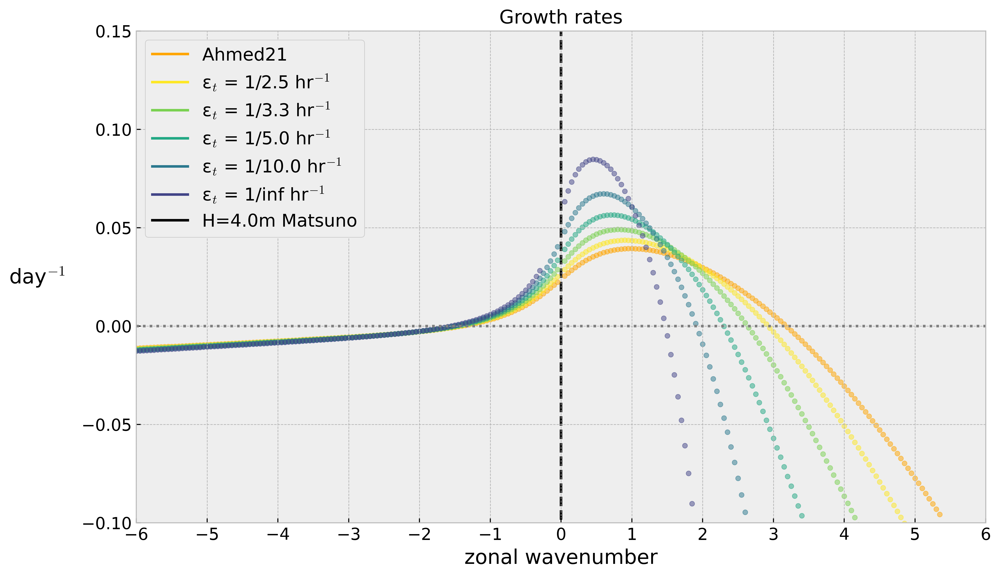

In [3656]:
plt.style.use('bmh')
fig,ax=plt.subplots(1,1,figsize=(12,7), dpi=500)

for no,exp_name in enumerate(experiments):
    for i in range(disp_growthp[exp_name].shape[1]):
        growthp=np.copy(disp_growthp[exp_name][:,i])
        ax.scatter(klist[exp_name],growthp*24,s=15,c=colors[exp_name],alpha=0.5)
        growthm=np.copy(disp_growthm[exp_name][:,i])
        ax.scatter(klist[exp_name],growthm*24,s=15,c=colors[exp_name],alpha=0.5)

        if no == 0:
            ln[exp_name] = mlines.Line2D(
                [], [], color=colors[exp_name], linestyle="-", label='Ahmed21'
            )
        
        elif model_type[exp_name] == 'A':
            ln[exp_name] = mlines.Line2D(
                [], [], color=colors[exp_name], linestyle="-", 
                label=(
                    # r"ε$_q$ = 1/" + f"{1/(3600*epsq[exp_name]):0.1f}" + r" hr$^{-1}$, "
                    r"ε$_t$ = 1/" + f"{1/(3600*epst[exp_name]):0.1f}" + r" hr$^{-1}$ "
                    # + r"ε$_t$/ε$_q$ = " + f"{epst[exp_name]/epsq[exp_name]:0.1f}"
                )
            )
        
        elif model_type[exp_name] == 'D':
            ln[exp_name] = mlines.Line2D(
                [], [], color=colors[exp_name], linestyle="-", 
                label=r"WTG, ε$_q$ = 1/" + f"{1/(3600*epsq[exp_name]):0.1f}" + r" hr$^{-1}$"
            )

        elif model_type[exp_name] == 'WS22':
            ln[exp_name] = mlines.Line2D(
                [], [], color=colors[exp_name], linestyle="-", 
                label=r"WS22, ε$_q$ = 1/" + f"{1/(3600*epsq[exp_name]):0.1f}" + r" hr$^{-1}$"
            )

        elif model_type[exp_name] == 'H':
            ln[exp_name] = mlines.Line2D(
                [], [], color=colors[exp_name], linestyle="-", 
                label=r"$\alpha$ = 1/" + f"{1/(3600*alpha[exp_name]):0.1f}" + r" hr$^{-1}$"
            )
            
    ax.vlines(0,0.5*24,-0.9,linestyle='--',zorder=-1,color='black')
    ax.axhline(y=0, ls=':', color='gray')
    # ax.axvline(x=solution_k[exp_name], ls=':', color='gray')

    ax.tick_params(which='both',labelsize=13)
    ax.set_title('Growth rates',fontsize=15)
    ax.set_xlim(-6,6.)
    ax.set_ylim(-0.1, 0.15)
    ax.set_ylabel('day$^{-1}$',fontsize=16, rotation=0, labelpad=35, va='center')
    ax.set_xlabel('zonal wavenumber', fontsize=16)

leg_names = []
leg_labels = []
for n, exp_name in enumerate(experiments):
    leg_names.append(ln[exp_name])
    leg_labels.append(exp_name)
for _, mats_exp in enumerate(matsuno_experiments[:1]):
    leg_names.append(ln[mats_exp])
    leg_labels.append(mats_exp)
leg = ax.legend(handles=leg_names, ncol=1, fontsize=14, loc="upper left")
leg.get_frame().set_alpha(1)


# ax.set_xticks(np.arange(-15, 17, 3))
ax.set_xticks(np.arange(-6, 7, 1))
# ax.set_xticks([-15, -10, -5, -4, -3, -2, -1, 0, 1, 2, 3, 4, 5, 10, 15]) 
plt.show()

## Frequencies and Growth Rates

In [4549]:
for e in range(len(experiments)):
    for exp in experiments[:e]:
        print(exp)

meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.70_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.70_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=7.50_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.70_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=7.50_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=8.60_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.70_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=7.50_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=8.60_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=10.00_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.70_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=7.50_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=8.60_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_

0
1
2


/tmp/ipykernel_2563720/838946449.py:141: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax[1].scatter(
/tmp/ipykernel_2563720/838946449.py:149: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax[1].scatter(


3


/tmp/ipykernel_2563720/838946449.py:141: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax[1].scatter(
/tmp/ipykernel_2563720/838946449.py:149: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax[1].scatter(


4


/tmp/ipykernel_2563720/838946449.py:141: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax[1].scatter(
/tmp/ipykernel_2563720/838946449.py:149: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax[1].scatter(


5


/tmp/ipykernel_2563720/838946449.py:141: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax[1].scatter(
/tmp/ipykernel_2563720/838946449.py:149: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  ax[1].scatter(


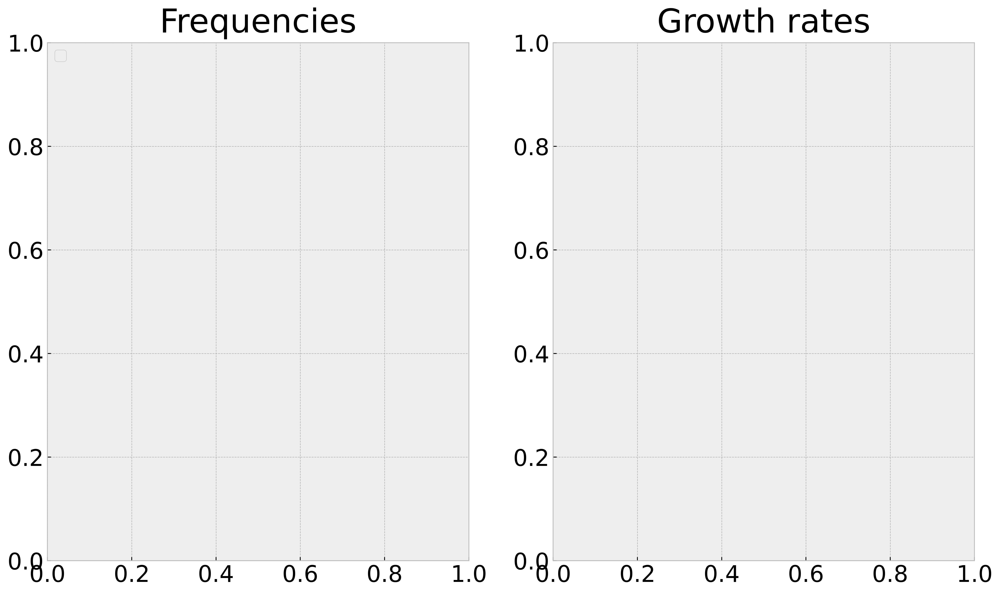

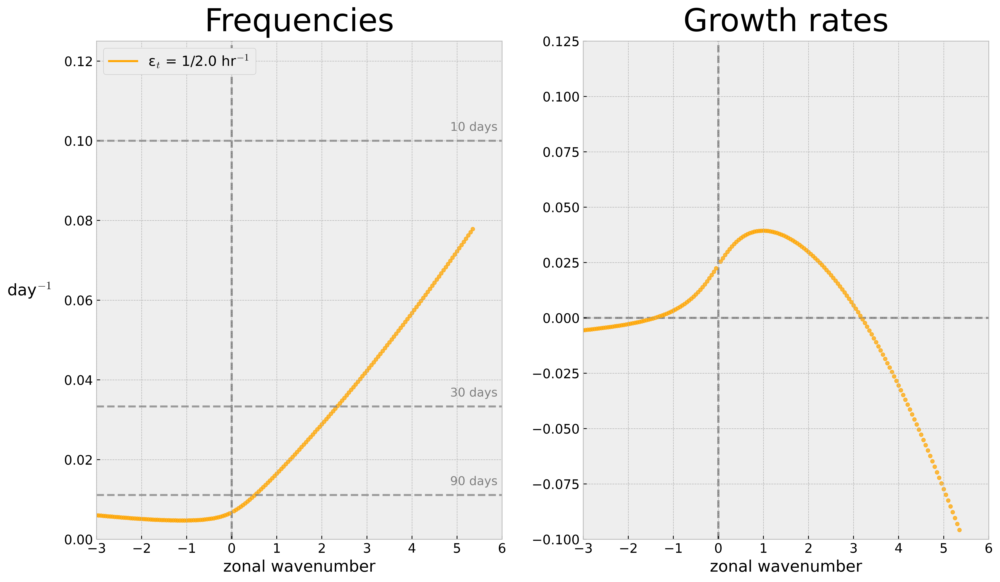

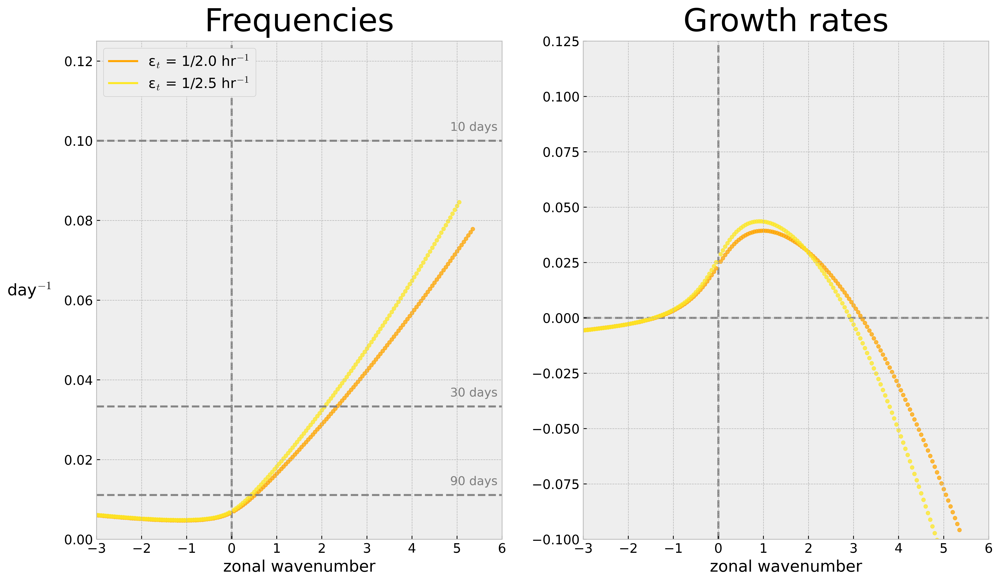

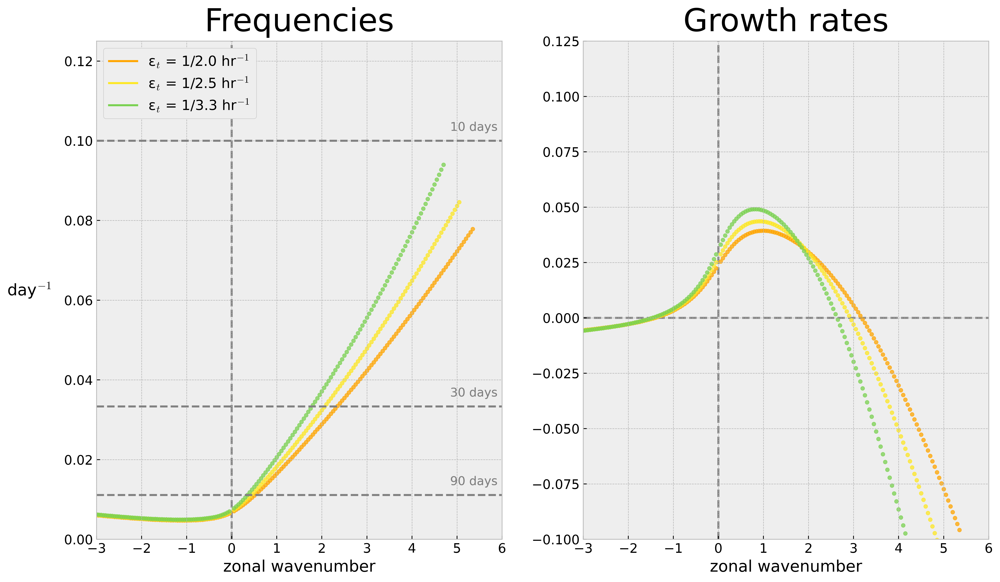

Error in callback <function flush_figures at 0x7fcbf81d6b80> (for post_execute):


KeyboardInterrupt: 

In [4550]:
for e in range(len(experiments)):
    print(e)
    plt.style.use('bmh')
    plt.rcParams.update({'font.size':22})
    [fig, ax] = plt.subplots(1, 2, figsize=(16,9), dpi=500)
    
    ln = {}
    # # Dry Matsuno Solutions
    # for mats_no, mats_exp in enumerate(matsuno_experiments):
    #     wavenumber = matsuno_klist[mats_exp]
    #     frequency = matsuno_frequencies[mats_exp]
    #     H = equivalent_depth[mats_exp]
    
    #     for i in range(frequency.shape[1]):
    #         ax[0].scatter(
    #             -float(Re[experiments[0]]) * wavenumber,
    #             frequency[:, i] * 24/(2*np.pi),
    #             s=5,
    #             edgecolor='black',
    #             alpha=1,
    #             marker='o',
    #             facecolor='black'
    #         )
    
    #         ln[mats_exp] = mlines.Line2D(
    #             [], [], color='black', linestyle="-", label=f"H={H}m Matsuno"
    #         )
    
    ax[0].set_title('Frequencies', pad=10)
    for no,exp_name in enumerate(experiments[:e]):
        for i in range(disp_freqp[exp_name].shape[1]):
            freqp=np.copy(disp_freqp[exp_name][:,i])
            ax[0].scatter(
                klist[exp_name],
                freqp * 24/(2*np.pi),
                s=15,
                edgecolor=colors[exp_name],
                facecolor=colors[exp_name],
                # facecolor='None',
                alpha=0.75,             
                marker='o',
            )
            freqm=np.copy(disp_freqm[exp_name][:,i])
            ax[0].scatter(
                klist[exp_name],
                freqm*24/(2*np.pi),
                s=15,
                edgecolor=colors[exp_name],
                facecolor=colors[exp_name],
                # facecolor='None',
                alpha=0.75,             
                marker='o',
            )
    
            # if no == 0:
            #     ln[exp_name] = mlines.Line2D(
            #         [], [], color=colors[exp_name], linestyle="-", label='Ahmed21'
            #     )
    
            if model_type[exp_name] == 'A':
            # elif model_type[exp_name] == 'A':
                ln[exp_name] = mlines.Line2D(
                    [], [], color=colors[exp_name], linestyle="-", 
                    label=(
                        # f"k={solution_k[exp_name]:0.2f}, "
                        # r"ε$_q$ = 1/" + f"{1/(3600*epsq[exp_name]):0.1f}" + r" hr$^{-1}$, "
                        r"ε$_t$ = 1/" + f"{1/(3600*epst[exp_name]):0.1f}" + r" hr$^{-1}$ "
                        # r"ε$_t$/ε$_q$ = " + f"{epst[exp_name]/epsq[exp_name]:0.1f}"
                    )
                )
            
            elif model_type[exp_name] == 'D':
                ln[exp_name] = mlines.Line2D(
                    [], [], color=colors[exp_name], linestyle="-", 
                    label=r"WTG, ε$_q$ = 1/" + f"{1/(3600*epsq[exp_name]):0.1f}" + r" hr$^{-1}$"
                )
    
            elif model_type[exp_name] == 'WS22':
                ln[exp_name] = mlines.Line2D(
                    [], [], color=colors[exp_name], linestyle="-", 
                    label=(
                        r"WS22, ε$_q$ = 1/" + f"{1/(3600*epsq[exp_name]):0.1f}" + r" hr$^{-1}$ "
                        + r"ε$_t$ = 1/" + f"{1/(24*3600*epst[exp_name]):0.1f}" + r" day$^{-1}$ "
                        + r"α = 1/" + f"{1/(24*3600*alpha[exp_name]):0.1f}" + r" day$^{-1}$ "
                    )
                )
            
    
            elif model_type[exp_name] == 'H':
                ln[exp_name] = mlines.Line2D(
                    [], [], color=colors[exp_name], linestyle="-", 
                    label=(
                        r"H, ε$_t$ = 1/" + f"{1/(3600*epst[exp_name]):0.1f}" + r" hr$^{-1}$, "
                        + r"α = 1/" + f"{1/(24*3600*alpha[exp_name]):0.1f}" + r" day$^{-1}$ "
                    )
                )
    
            elif model_type[exp_name] == 'J':
                    ln[exp_name] = mlines.Line2D(
                        [], [], color=colors[exp_name], linestyle="-", 
                        label=(
                            r"J, ε$_t$ = 1/" + f"{1/(3600*epst[exp_name]):0.1f}" + r" hr$^{-1}$, "
                            + r"α = 1/" + f"{1/(24*3600*alpha[exp_name]):0.1f}" + r" day$^{-1}$ "
                        )
                    )
                    
        
        ax[0].axvline(x=0, linestyle='--',zorder=-1,color='gray')
        ax[0].axhline(y=1/90, color='gray', alpha=0.75, ls='--')
        ax[0].text(5.9, (1/90+0.0025), '90 days', ha='right', color='gray', fontsize=12)
        ax[0].axhline(y=1/30, color='gray', alpha=0.75, ls='--')
        ax[0].text(5.9, (1/30+0.0025), '30 days', ha='right', color='gray', fontsize=12)
        ax[0].axhline(y=1/10, color='gray', alpha=0.75, ls='--')
        ax[0].text(5.9, (1/10+0.0025), '10 days', ha='right', color='gray', fontsize=12)
    
        ax[0].tick_params(which='both',labelsize=13)
        ax[0].set_ylim(bottom=0.0,top=10)
        ax[0].set_xlim(-3,6.)
        # ax[0].set_ylim(0, 1/(2*np.pi))
        ax[0].set_ylim(0, 0.125)
        ax[0].set_ylabel('day$^{-1}$',fontsize=16, rotation=0, labelpad=35, va='center')
        ax[0].set_xlabel('zonal wavenumber', fontsize=16)
        ax[0].set_xticks(np.arange(-3, 7, 1))
        ax[0].set_aspect('auto')
    
    leg_names = []
    leg_labels = []
    for n, exp_name in enumerate(experiments[:e]):
        leg_names.append(ln[exp_name])
        leg_labels.append(exp_name)
    # for _, mats_exp in enumerate(matsuno_experiments[:1]):
        # leg_names.append(ln[mats_exp])
        # leg_labels.append(mats_exp)
    leg = ax[0].legend(handles=leg_names[:6], ncol=1, fontsize=14, loc="upper left")
    leg.get_frame().set_alpha(1)
    
    ax[1].set_title('Growth rates', pad=10)
    for no,exp_name in enumerate(experiments[:e]):
        for i in range(disp_growthp[exp_name].shape[1]):
            growthp=np.copy(disp_growthp[exp_name][:,i])
            ax[1].scatter(
                klist[exp_name],
                growthp*24,
                s=15,
                c=colors[exp_name],
                alpha=0.75
            )
            growthm=np.copy(disp_growthm[exp_name][:,i])
            ax[1].scatter(
                klist[exp_name],
                growthm*24,
                s=15,
                c=colors[exp_name],
                alpha=0.75
            )
    
        ax[1].axhline(y=0, linestyle='--',zorder=-1,color='gray')
        ax[1].axvline(x=0, linestyle='--',zorder=-1,color='gray')
        # ax.axvline(x=solution_k[exp_name], ls=':', color='gray')
    
        ax[1].tick_params(which='both',labelsize=13)
        ax[1].set_xlim(-3,6.)
        # ax[1].set_ylim(-0.5, 0.125)
        ax[1].set_ylim(-0.1, 0.125)
        # ax[1].set_ylabel('day$^{-1}$',fontsize=16, rotation=0, labelpad=35, va='center')
        ax[1].set_xlabel('zonal wavenumber', fontsize=16)
    
        ax[1].set_xticks(np.arange(-3, 7, 1))
        ax[1].set_aspect('auto')
    
    # plt.show()
    plt.savefig(
        f"./figures/2-panel_frequency-growth-plots_{e}.png",
        bbox_inches='tight',
        dpi=500
    )

# Plot the meridional structure (Fig. 4 in Ahmed 2021) ###

## Choose colormap

In [521]:
##choose colormap
pal=sns.choose_colorbrewer_palette('diverging',as_cmap=True)

interactive(children=(Dropdown(description='name', options=('RdBu', 'RdGy', 'PRGn', 'PiYG', 'BrBG', 'RdYlBu', …

## Set contour levels

In [561]:
## Set ranges for plotting ##
vel_range=np.arange(-3.0,3.5,0.5)*2.0
omega_range=vel_range*1e-6
that_range=np.arange(-0.15,0.2,0.05)*1e0
# qhat_range=np.arange(-2.0,2.2,0.2)*0.5*delpg/cp
# qhat_range=np.arange(-6.0,6.5,0.5) ### in mm
qhat_range=np.arange(-30.0,30.5,0.5) ### in mm

# pcp_range=np.arange(-0.05,0.055,0.005)
pcp_range=np.arange(-5.0,5.5,0.5)

In [1770]:
# np.min(qhat[exp_name].T*scale*delpg*cp/Lv)
qhat_range=np.arange(-2.0,2.2,0.2)*0.5*delpg/cp
qhat_range

array([-8.11457784e+00, -7.30312006e+00, -6.49166227e+00, -5.68020449e+00,
       -4.86874670e+00, -4.05728892e+00, -3.24583114e+00, -2.43437335e+00,
       -1.62291557e+00, -8.11457784e-01, -1.80179823e-15,  8.11457784e-01,
        1.62291557e+00,  2.43437335e+00,  3.24583114e+00,  4.05728892e+00,
        4.86874670e+00,  5.68020449e+00,  6.49166227e+00,  7.30312006e+00,
        8.11457784e+00])

## Formatting

In [514]:
def fmt(x, pos):
    a, b = '{:.2e}'.format(x).split('e')
    b = int(b)
    return r'${} \times 10^{{{}}}$'.format(a, b)


In [3125]:
## functions to transform x and y to lat and lon values

def xtolon(x, pos, offset=180):
    'The two args are the value and tick position'
    val=(x*360/(2*np.pi*Re[exp_name]*1e-6)-offset)
    val=np.round(val/10)*10 ## rounding to convert 59W to 60W
    if val<180 and val>0:
        return '$%d\mathrm{ °E}$' % (val)
    elif val<0:
        return '$%d\mathrm{ °W}$' % (abs(val))
    else:
        return '$%d$' % (val)

def ytolat(y, pos):
    'The two args are the value and tick position'
    if y>0:
        return '${%d }\mathrm{ °N}$' % (y/111e-3) 
    elif y<0: 
        return '${%d }\mathrm{ °S}$' % (y/111e-3)
    elif y==0:
        return '${%d }$' % (y/111e-3)


## Plot horizontal structures

In [4160]:
# ## functions to transform x and y to lat and lon values
# ylocs=np.arange(-30,35.0,2.5)*111

# ## The next cell re-produces Fig. 4 in Ahmed 2021

# exp_name=experiments[-1]

# scale=5/u[exp_name].values.max()  # scale structures such that max zonal wind is 5 m/s
# u_norm=-np.copy(u[exp_name]*scale)
# v_norm=-np.copy(v[exp_name]*scale)
# # u_norm[:]=0.0
# xarr=x[exp_name]*Re*1e-3
# yarr=y[exp_name]*1e-3
# X, Y = np.meshgrid(xarr, yarr,indexing='ij')
# xiint=1
# yiint=32

# pcp_scale=24*delpg*cp/Lv ## convert to mm/d

# xlims=[20e3,39e3]
# ylims=[-3.5e3,3.5e3]
# scale_vec=0.0025*0.25
# # quiverkey_length=5.00/3e2

# fig,axx=plt.subplots(1,2,figsize=(14.5,4.0))
# # plt.suptitle('%s Run'%(exp_name),fontsize=15)


# ax=axx[0]

# CS=ax.contour(x[exp_name]*1e-3*Re,y[exp_name]*1e-3,That[exp_name].T*scale,
#               levels=that_range*scale,extend='both',colors='black',linewidth=3)


# CT=ax.contourf(x[exp_name]*1e-3*Re,y[exp_name]*1e-3,pcp[exp_name].T*pcp_scale*scale,
#            levels=pcp_range*scale,extend='both',cmap=Ahmed_cmap,inline=True,fontsize=12)

# ax.clabel(CS, CS.levels, inline=True, fmt='%.2f', fontsize=10)


# ax.set_title('(a) ERW precipitation and temperature',fontsize=15)
# ax.tick_params(which='both',labelsize=13)

# ax.set_xlim(xlims)
# ax.set_ylim(ylims)

# xlocs=np.arange(0,390,30)*2*np.pi*Re*1e-3/(360)
# xmajorLocator = matplotlib.ticker.FixedLocator(locs=xlocs) 
# xmajorFormatter = matplotlib.ticker.FuncFormatter(xtolon)

# ax.xaxis.set_major_locator( xmajorLocator )
# ax.xaxis.set_major_formatter( xmajorFormatter )

# ylocs=np.arange(-30,40.0,10.0)*111
# ymajorLocator = matplotlib.ticker.FixedLocator(locs=ylocs) 
# ymajorFormatter = matplotlib.ticker.FuncFormatter(ytolat)

# ax.yaxis.set_major_locator( ymajorLocator )
# ax.yaxis.set_major_formatter( ymajorFormatter )


# axpos = ax.get_position()
# pos_x = axpos.x0+0.12*axpos.width #+ 0.025# + 0.25*axpos.width
# pos_y = axpos.y0-0.2*axpos.height
# cax_width = axpos.width*0.75
# cax_height = 0.025#axpos.height

# pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])
# CB=plt.colorbar(CT, cax=pos_cax,label='mm $\mathrm{d}^{-1}$',
#                 orientation='horizontal',format="%.1f",
#                ticks=matplotlib.ticker.MultipleLocator(0.5))
# text=CB.ax.xaxis.label

# font = matplotlib.font_manager.FontProperties(family='Arial',  size=14)

# text.set_font_properties(font)


# pos_cax.yaxis.label.set_font_properties(font)
# pos_cax.tick_params(which='both',labelsize=12.)


# ax=axx[1]

# CT=ax.contourf(x[exp_name]*1e-3*Re,y[exp_name]*1e-3,qhat[exp_name].T*scale*delpg*cp/Lv,
#                levels=qhat_range*scale*0.5,extend='both',cmap=Ahmed_cmap)

# CS=ax.contour(x[exp_name]*1e-3*Re,y[exp_name]*1e-3,That[exp_name].T*scale,
#               levels=that_range*scale,extend='both',colors='black',linewidth=3)

# # CS=ax.contour(x[exp_name]*1e-3*Re,y[exp_name]*1e-3,omega[exp_name].T*1e6*scale,colors='magenta',
# #                levels=np.delete(vel_range*scale,np.where(vel_range==0)),extend='both')


# ax.clabel(CS, CS.levels, inline=True, fmt='%.2f', fontsize=10)


# q=ax.quiver(X[::xiint,::yiint],Y[::xiint,::yiint],u_norm[::xiint,::yiint],
#             v_norm[::xiint,::yiint],angles='uv',
#             scale_units='xy',units='xy',
#             scale=scale_vec,pivot='middle',alpha=1.0,color='black',
#            headwidth=6,headlength=7,headaxislength=4.5,zorder=10)

# ax.quiverkey(q, X=0.935, Y=-.2, U=1.0,
#              label='1 $\mathrm{ms}^{-1}$',
#              labelpos='S',color='black',fontproperties={'size': '13'})


# # ax.set_title('(b) ERW moisture, divergence and winds',fontsize=15)
# ax.tick_params(which='both',labelsize=13)

# ax.set_xlim(xlims)
# ax.set_ylim(ylims)

# xlocs=np.arange(0,390,30)*2*np.pi*Re*1e-3/(360)
# xmajorLocator = matplotlib.ticker.FixedLocator(locs=xlocs) 
# xmajorFormatter = matplotlib.ticker.FuncFormatter(xtolon)

# ax.xaxis.set_major_locator( xmajorLocator )
# ax.xaxis.set_major_formatter( xmajorFormatter )

# ylocs=np.arange(-30,40.0,10.0)*111
# ymajorLocator = matplotlib.ticker.FixedLocator(locs=ylocs) 
# ymajorFormatter = matplotlib.ticker.FuncFormatter(ytolat)

# ax.yaxis.set_major_locator( ymajorLocator )
# ax.yaxis.set_major_formatter( ymajorFormatter )

# axpos = ax.get_position()
# pos_x = axpos.x0+0.05*axpos.width #+ 0.025# + 0.25*axpos.width
# pos_y = axpos.y0-0.2*axpos.height
# cax_width = axpos.width*0.75
# cax_height = 0.025#axpos.height

# pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])
# CB=plt.colorbar(CT, cax=pos_cax,label='mm',orientation='horizontal',format="%.1f",
#                ticks=matplotlib.ticker.MultipleLocator(0.2))
# text=CB.ax.xaxis.label

# font = matplotlib.font_manager.FontProperties(family='Arial',  size=14)

# text.set_font_properties(font)


# pos_cax.yaxis.label.set_font_properties(font)
# pos_cax.tick_params(which='both',labelsize=12.)

# SAVE=False
# if SAVE:
#     plt.savefig('./Fig_merid_struct_ERW_waveno2.pdf',
#                format='pdf',dpi=125,bbox_inches='tight')

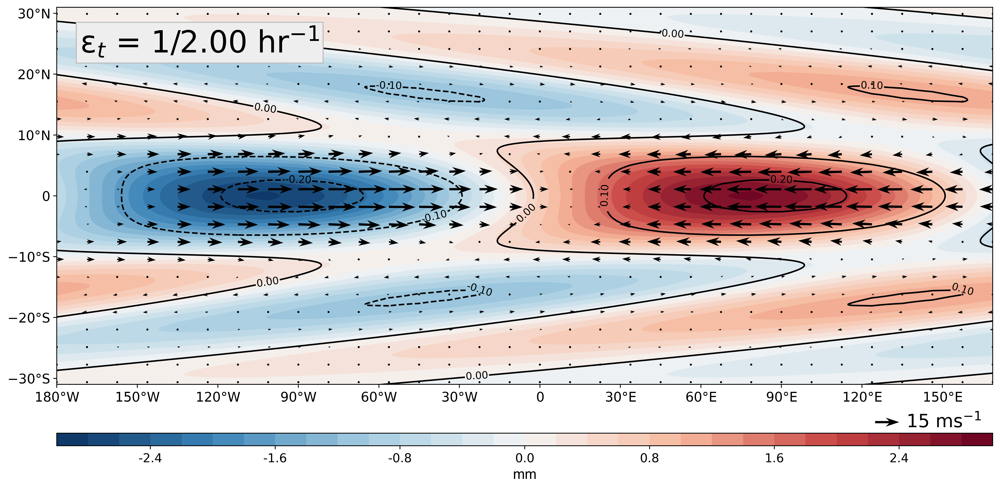

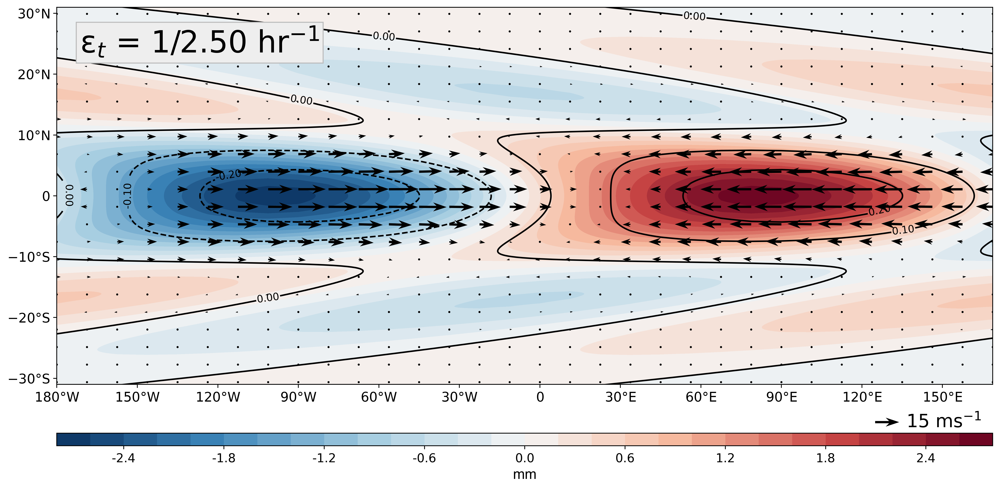

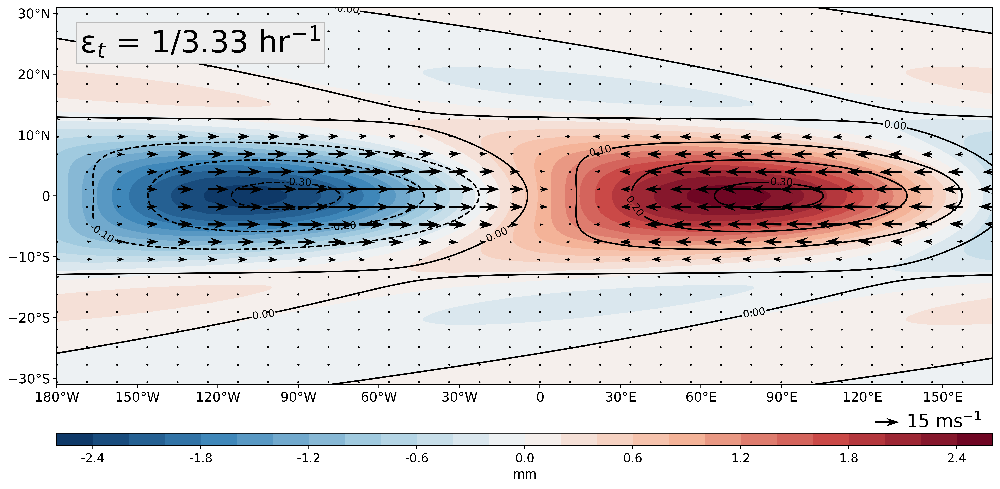

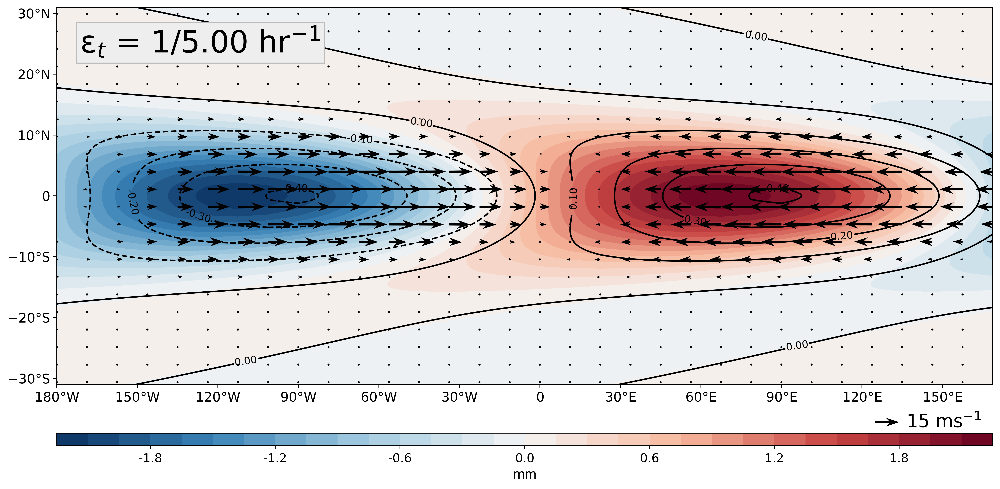

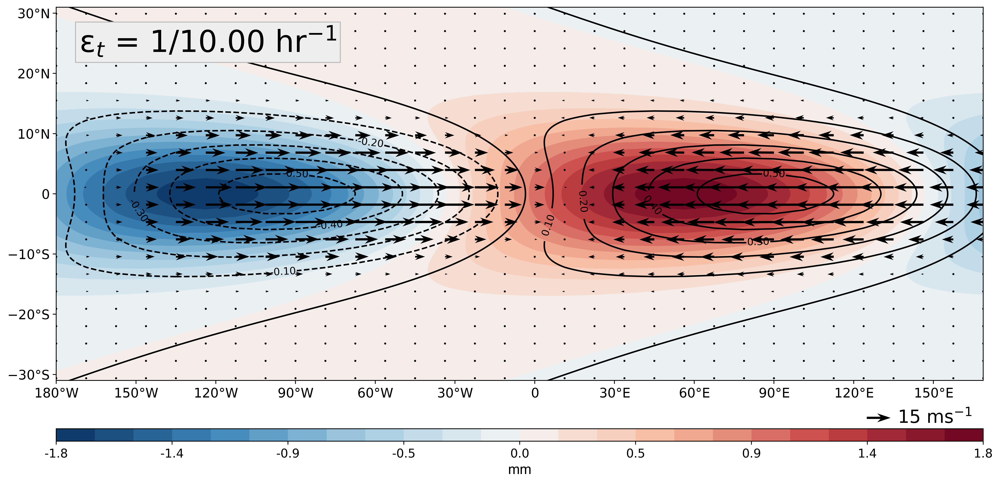

/tmp/ipykernel_2563720/4202164695.py:162: RuntimeWarning: divide by zero encountered in scalar divide
  r'ε$_t$ = ' + f"1/{1/(3600*epst[exp_name]):0.2f} " + r"$\text{hr}^{-1}$"


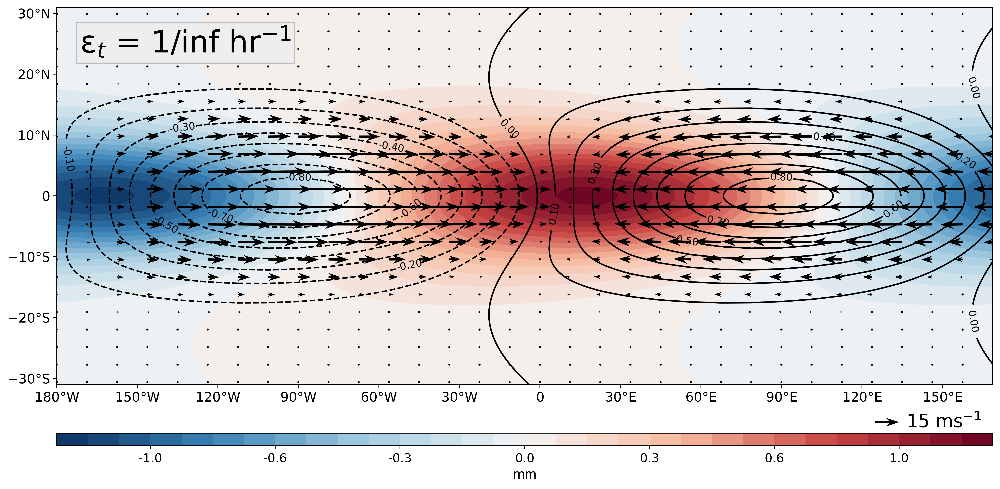

In [4198]:
## The next cell re-produces Fig. 4 in Ahmed 2021
# exp_name = experiments[1]

for exp_name in experiments:
    # scale=5/u[exp_name].values.max()  # scale structures such that max zonal wind is 5 m/s
    # scale=1/(qhat[exp_name].values.max()*delpg*cp/Lv)  # scale structures such that max moisture anomaly is 1 mm
    # scale=0.1/(That[exp_name].values.max())  # scale structures such that max temperature anomaly is 0.1 K
    scale=1/(h[exp_name].values.max())  # scale structures such that max temperature anomaly is 0.1 K
    u_norm=-np.copy(u[exp_name]*scale)
    v_norm=-np.copy(v[exp_name]*scale)
    # u_norm[:]=0.0
    xarr=x[exp_name]*Re[exp_name]*1e-6
    yarr=y[exp_name]*1e-6
    xiint=1
    # yiint=32
    yiint=32
    
    moisture_x_max = np.argmax(That[exp_name].values[:, 1001//2])
    if solution_k[exp_name] == 1:
        shifted_location = int(3*len(x[exp_name])/4)
        # shifted_location = int(1*len(x[exp_name])/2)
    elif solution_k[exp_name] == 2:
        shifted_location = int(7*len(x[exp_name])/8)
        # shifted_location = int(1*len(x[exp_name])/2)
    elif solution_k[exp_name] == 3:
        shifted_location = int(7*len(x[exp_name])/8)
    # shifted_location = 28
    roll = shifted_location - moisture_x_max
    
    rolled_That = np.roll(That[exp_name], axis=0, shift=roll)
    rolled_qhat = np.roll(qhat[exp_name], axis=0, shift=roll)
    rolled_u = np.roll(u_norm, axis=0, shift=roll)
    rolled_v = np.roll(v_norm, axis=0, shift=roll)
    
    X, Y = np.meshgrid(xarr, yarr, indexing='ij')
    
    pcp_scale=24*delpg*cp/Lv ## convert to mm/d
    
    # scale_vec=0.0025*0.25
    # scale_vec=0.0025*0.5
    # quiverkey_length=5.00/3e2
    
    plt.style.use('default')
    plt.rcParams.update({'font.size':28})
    # fig = plt.figure(figsize=(14.5, 8.0), dpi=500)
    fig = plt.figure(figsize=(16, 8.0), dpi=500)
    gs_main = gs.GridSpec(2, 1, height_ratios = [30,1], figure=fig)
    pos_cax = fig.add_subplot(gs_main[-1])
        
    # Update the bounds and spacing of the gs.GridSpec
    gs_main.update(left=0.1, right=0.9, top=0.8, bottom=0.05, hspace=0.25)
    
    # Add an axis for the initial condition
    ax = fig.add_subplot(gs_main[0])
    # ax.set_title(r'ε$_{t}$ ='+ f"1/{1/(3600*epst[exp_name]):0.1f}" + r' hr$^{-1}$', pad=15)
    CS=ax.contour(
        xarr,
        yarr,
        # rolled_x,
        # rolled_y,
        # That[exp_name].T*scale,
        rolled_That.T*scale,
        # levels=that_range*scale,
        # levels=15,
        levels=np.linspace(-1, 1, 21),
        colors='black'
    )
    ax.clabel(CS, CS.levels, inline=True, fmt='%.2f', fontsize=10)
    
    CT = ax.contourf(
        # x[exp_name]*1e-3*Re[exp_name],
        # y[exp_name]*1e-3,
        xarr,
        yarr,
        # rolled_x,
        # rolled_y,
        rolled_qhat.T*scale*delpg*cp/Lv,
        # levels=qhat_range*scale*0.5,
        # levels=np.linspace(-1,1,30),
        levels=30,
        # extend='both',
        cmap=Ahmed_cmap
    )
    
    axpos = ax.get_position()
    pos_x = axpos.x0+0.05*axpos.width #+ 0.025# + 0.25*axpos.width
    pos_y = axpos.y0-0.2*axpos.height
    cax_width = axpos.width*0.75
    cax_height = 0.025#axpos.height
    
    # pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])
    CB=plt.colorbar(
        CT, 
        cax=pos_cax,
        label='mm',
        orientation='horizontal',
        format="%.1f",
        # ticks=matplotlib.ticker.MultipleLocator(0.2))
    )
    text=CB.ax.xaxis.label
    font = matplotlib.font_manager.FontProperties(family='Arial',  size=14)
    text.set_font_properties(font)
    pos_cax.yaxis.label.set_font_properties(font)
    pos_cax.tick_params(which='both',labelsize=12.)
    
    # ax.set_title('(a) ERW precipitation and temperature',fontsize=15)
    ax.tick_params(which='both',labelsize=13)
    
    vector_scale = 15
    key_length = 1
    q=ax.quiver(
        X[::xiint,::yiint],
        Y[::xiint,::yiint],
        rolled_u[::xiint,::yiint],
        rolled_v[::xiint,::yiint],
        # X[9,1001//2],
        # Y[9,1001//2],
        # rolled_u[9,1001//2],
        # rolled_v[9,1001//2],
        angles='xy',
        scale_units='xy',
        units='xy',
        scale=vector_scale,
        # pivot='middle',
        pivot='tail',
        alpha=1.0,
        color='black',
        headwidth=4,
        headlength=6,
        headaxislength=4.5,
        zorder=10
    )
    
    # ax.quiverkey(q, X=0.935, Y=-.2, U=1.0,
    #              label='1 $\mathrm{ms}^{-1}$',
    #              labelpos='S',color='black',fontproperties={'size': '13'})
    
    ax.quiverkey(
        q, 
        X=0.9,
        # Y=1.025,
        Y=-0.1,
        # X=10,
        # Y=3,
        U=vector_scale*key_length,
        label=f"{vector_scale*key_length}" + r' $\mathrm{ms}^{-1}$',
        # label=f"{0.1/np.max(u_norm):0.2f}" + r' $\mathrm{ms}^{-1}$',
        labelpos='E',
        color='black',
        fontproperties={'size': '18'},
        coordinates='axes'
        # coordinates='data'
    )

    ax.text(
        # x=38.9557489*(5/360),
        # y=29*111e-3,
        x=0.025,
        y=0.95,
        s=(
            # r'ε$_q$ = ' + f"{3600*epsq[exp_name]:0.3f}, " 
            r'ε$_t$ = ' + f"1/{1/(3600*epst[exp_name]):0.2f} " + r"$\text{hr}^{-1}$"
            # + r'ε$_t$/ε$_q$ = ' + f"{epst[exp_name]/epsq[exp_name]:0.2f}"
        ),
        bbox={'fc':'#eeeeee', 'ec':'#bcbcbc'},
        ha='left',
        va='top',
        fontsize=30,
        zorder=11,
        transform=ax.transAxes
    )
        
        
    ax.tick_params(which='both',labelsize=13)
    
    # xlims=[20e3,39e3]
    
    # ylims=[-3.5e3,3.5e3]
    # ylims=[-4.4e3,4.4e3]
    
    # ax.set_xlim(xlims)
    # ax.set_ylim(ylims)

    # xlims=[19,38]
    if solution_k[exp_name] == 1:
        ax.set_xlim([0, 38.9557489])
        xlocs=np.arange(0,390,30)*2*np.pi*Re[exp_name]*1e-6/(360)
    elif solution_k[exp_name] == 2:
        # ax.set_xlim([19.47787445, 38.9557489])
        # xlocs=np.arange(180,390,30)*2*np.pi*Re[exp_name]*1e-6/(360)
        ax.set_xlim([0, 38.9557489])
        xlocs=np.arange(0,390,30)*2*np.pi*Re[exp_name]*1e-6/(360)
    elif solution_k[exp_name] == 3:
        ax.set_xlim([2*38.9557489/3, 38.9557489])
        xlocs=np.arange(240,390,30)*2*np.pi*Re[exp_name]*1e-6/(360)
    
    xmajorLocator = matplotlib.ticker.FixedLocator(locs=xlocs) 
    xmajorFormatter = matplotlib.ticker.FuncFormatter(xtolon)
    
    ax.xaxis.set_major_locator( xmajorLocator )
    ax.xaxis.set_major_formatter( xmajorFormatter )
    
    ax.set_ylim(-31*111e-3,31*111e-3)
    ylocs=np.arange(-40,50.0,10.0)*111e-3
    ymajorLocator = matplotlib.ticker.FixedLocator(locs=ylocs) 
    ymajorFormatter = matplotlib.ticker.FuncFormatter(ytolat)
    
    ax.yaxis.set_major_locator( ymajorLocator )
    ax.yaxis.set_major_formatter( ymajorFormatter )
    
    ax.set_aspect('auto')
    plt.show()
    # plt.savefig(
    #     (
    #         f"./figures/model_{model_type[exp_name]}_k={solution_k[exp_name]:0.2f}"
    #         + f"_epsq={epsq[exp_name]*3600:0.3f}_epst={epst[exp_name]*3600:0.3f}"
    #         + f"_horizontal_structure.png"
        
    #     ), 
    #     bbox_inches='tight',
    #     dpi=350
    # )

# Budget analysis

## Define budget calculation

In [3792]:
def calculate_budget(field_variable, budget_variable):
    budget = np.einsum(
        '...ji, ...ji -> ...',
        field_variable,
        budget_variable
    ) / np.einsum(
        '...ji, ...ji -> ...',
        budget_variable,
        budget_variable
    )
    return budget

## Growth budget

### Calculate growth budget

In [4611]:
multi_experiment_growth_budgets = xr.Dataset(
    data_vars=dict(
        growth=(["experiment"], np.empty((len(experiments)))),
        omega=(["experiment"], np.empty((len(experiments)))),
        u=(["experiment"], np.empty((len(experiments)))),
        v=(["experiment"], np.empty((len(experiments)))),
        Qr=(["experiment"], np.empty((len(experiments)))),
), 
    coords=dict(
        experiment=experiments,
    ), 
)

for exp_index, exp_name in enumerate(experiments):
# exp_name = experiments[1]
    
    budget_u = u[exp_name].values
    budget_v = v[exp_name].values
    budget_y = y[exp_name].values
    budget_omega = omega[exp_name].values
    budget_q = qhat[exp_name].values
    budget_T = That[exp_name].values
    
    # h = budget_q + budget_T
    budget_region = np.where(np.abs(budget_y)/METERS_PER_DEGREE <= 10)[0]
    # budget_region = np.where((budget_y/METERS_PER_DEGREE >= 10)*(budget_y/METERS_PER_DEGREE <= 30))[0]
    
    budget_Qc = epsq[exp_name]*budget_q - epst[exp_name]*budget_T
    budget_Qr = r[exp_name]*budget_Qc
    
    near_equatorial_h = h[exp_name][:, budget_region]
    near_equatorial_u = budget_u[:, budget_region]
    near_equatorial_v = budget_v[:, budget_region]
    near_equatorial_y = budget_y[budget_region]
    near_equatorial_omega = budget_omega[:, budget_region]
    near_equatorial_Qr = budget_Qr[:, budget_region]
    
    wv_index = np.abs(klist_read - solution_k[exp_name]).argmin()
    growth_value = (disp_growthm[exp_name][wv_index])[~np.isnan(disp_growthm[exp_name][wv_index])].squeeze()
    if (solution_k[exp_name] == 1.0) and (epst[exp_name] == 0) and (1/(3600*epsq[exp_name]) == 6.0):
        growth_value = (disp_growthp[exp_name][wv_index])[2].squeeze()
    if (solution_k[exp_name] == 1.0) and (epst[exp_name] == 0) and (1/(3600*epsq[exp_name]) == 3.0):
        growth_value = (disp_growthp[exp_name][wv_index])[4].squeeze()

    # elif (solution_k[exp_name] == 3.0) and (epst[exp_name] == 0):
    #     growth_value = (disp_growthp[exp_name][wv_index])[~np.isnan(disp_growthp[exp_name][wv_index])].squeeze()
    
    omega_term = 3600*(Ms[exp_name]-0.75*Ms[exp_name])/delpg*near_equatorial_omega
    omega_contribution = calculate_budget(omega_term, near_equatorial_h)
    # omega_contribution = (Ms[exp_name]-0.75*Ms[exp_name])/delpg*calculate_budget(
    #     near_equatorial_omega, 
    #     near_equatorial_h
    # )
    
    u_term = 3600*sigma_x[exp_name]/delpg*near_equatorial_u
    u_contribution = calculate_budget(u_term, near_equatorial_h)
    # u_contribution = sigma_x[exp_name]/delpg*calculate_budget(
    #     near_equatorial_u, 
    #     near_equatorial_h
    # )
    
    v_term = -3600*sigma_y[exp_name]/delpg*near_equatorial_y*near_equatorial_v
    v_contribution = calculate_budget(v_term, near_equatorial_h)
    # v_contribution = -sigma_y[exp_name]/delpg*calculate_budget(
    #     near_equatorial_y*near_equatorial_v, 
    #     near_equatorial_h
    # )
    
    Qr_term = 3600*near_equatorial_Qr
    Qr_contribution = calculate_budget(Qr_term, near_equatorial_h)
    # Qr_contribution = calculate_budget(near_equatorial_Qr, near_equatorial_h)

    multi_experiment_growth_budgets['growth'][exp_index] = growth_value
    multi_experiment_growth_budgets['omega'][exp_index] = omega_contribution
    multi_experiment_growth_budgets['u'][exp_index] = u_contribution
    multi_experiment_growth_budgets['v'][exp_index] = v_contribution
    multi_experiment_growth_budgets['Qr'][exp_index] = Qr_contribution

### Plot budget

#### Single experiment

In [4221]:
# bar_labels = [
#     "Growth",
#     f"Vertical \nadvection" ,
#     f"Zonal \nadvection",
#     f"Meridional \nadvection",
#     f"Column \nradiative \nheating",
# ]

# bar_values = [
#     growth_value,
#     omega_contribution,
#     u_contribution,
#     v_contribution,
#     Qr_contribution
# ]

# bar_colors = [
#     '#ffa500', 
#     '#1cf91a',
#     '#0533ff', 
#     '#ff40ff', 
#     '#4e2d8c', 
#     # 'red', 
# ]

# bar_positions = np.arange(len(bar_values))

# # Plot the budgets
# plt.style.use('default')
# plt.rcParams.update({'font.size':22})
# plt.figure(figsize=(16.5, 6.4))
# bar_container = plt.bar(bar_positions, bar_values, color=bar_colors, edgecolor='gray', linewidth=3)

# # plt.ylim(-0.2, 0.2)
# # plt.ylim(-1.05*round_out(grand_max, 'hundredths'), 1.05*round_out(grand_max, 'hundredths'))
# plt.axhline(y=0, color='gray', lw=3, alpha=0.75)
# plt.xticks(ticks=bar_positions, labels=bar_labels, rotation=0, fontsize=22)
# plt.ylabel(r'hr$^{-1}$', labelpad=35, rotation=0, va='center')
# plt.ylim(-0.015, 0.01)
# # plt.yticks([-0.02, -0.01, 0.0, 0.01])
# plt.show()
# # plt.savefig(
# #       f"{specified_output_file_directory}/{initial_condition_type}_initial-condition/figures/"
# #     + f"{specified_initial_condition_name}_MSE_growth-budget"
# #     + f"_{downsampled_timepoints[t]/SECONDS_PER_DAY:0.1f}-days"
# #     + f"_{mjo.tick_labeller([south_bound], 'lat')[0]}-{mjo.tick_labeller([north_bound], 'lat')[0]}"
# #     + (f"_{time.strftime('%Y%m%d-%H%M')}" if save_timestamp else '')
# #     + f".png", 
# #     bbox_inches='tight'
# # )

#### Multiple experiments

meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.70_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=7.50_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=8.60_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=10.00_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.100_cp=13.00_k=2.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.000_cp=16.00_k=2.00_model=A


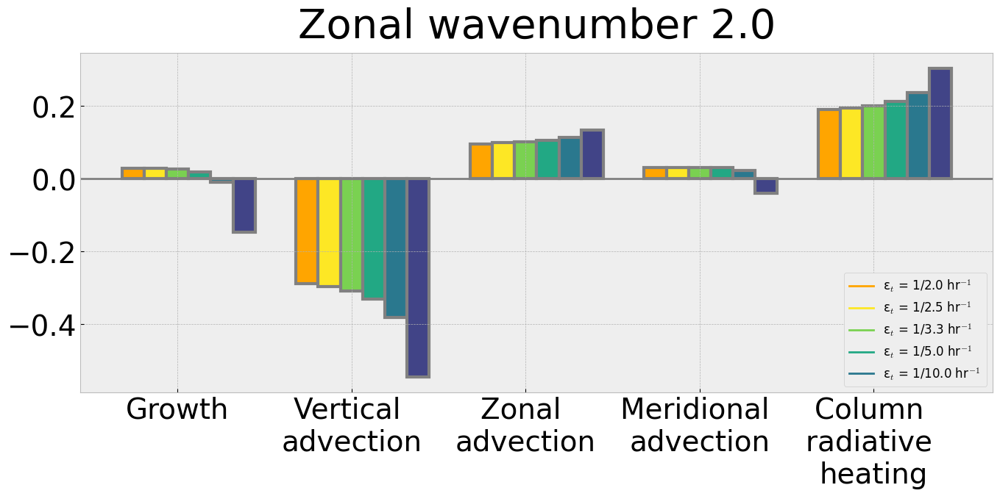

In [4612]:
plt.style.use('bmh')
fig = plt.figure(figsize=(16,6))
# fig = plt.figure(figsize=(16,3))
gs_main = gs.GridSpec(1, 1, figure=fig)
# gs_main.update(hspace=0.3)

bar_labels = [
    f"Growth",
    f"Vertical \nadvection" ,
    f"Zonal \nadvection",
    f"Meridional \nadvection",
    f"Column \nradiative \nheating",
]

process_colors = {
    'growth'                   : '#ffa500', 
    'propagation'              : '#ffa500', 
    'vertical advection'       : '#1cf91a',
    'omega'                    : '#1cf91a',
    'column processes'         : '#1cf91a',
    'zonal advection'          : '#0533ff',
    'u'                        : '#0533ff',
    'meridional advection'     : '#ff40ff', 
    'v'                        : '#ff40ff', 
    'column radiative heating' : '#4e2d8c',
    'Qr'                       : '#4e2d8c',
    'diffusion'                : '#A60628',
    'residual'                 : 'gray',
}

# ax = []
ax = fig.add_subplot(gs_main[0])
ax.set_title(f"Zonal wavenumber {solution_k[experiments[0]]}", pad=15)
# width = 0.1375
width = 0.125
# width = 0.3

grand_max = []
grand_min = []
for variable in multi_experiment_growth_budgets.data_vars:
    grand_max.append(24*multi_experiment_growth_budgets[variable].values.max())
    grand_min.append(24*multi_experiment_growth_budgets[variable].values.min())

grand_max = np.max(grand_max)
grand_min = np.min(grand_min)

# width = 0.1275
width = 0.1275
multiplier = 0
bar_locations = np.arange(len(bar_labels))
bar_max = []
for exp in multi_experiment_growth_budgets["experiment"].values:
    print(exp)
    offset = width * multiplier
    # if exp == experiments[0]:
    bar_values = [
            24*multi_experiment_growth_budgets['growth'].sel(experiment=exp),
            24*multi_experiment_growth_budgets['omega'].sel(experiment=exp),
            24*multi_experiment_growth_budgets['u'].sel(experiment=exp),
            24*multi_experiment_growth_budgets['v'].sel(experiment=exp),
            24*multi_experiment_growth_budgets['Qr'].sel(experiment=exp),
        ]

    # bar_values = [
    #         1,
    #         multi_experiment_growth_budgets['omega'].sel(experiment=exp).values/multi_experiment_growth_budgets['growth'].sel(experiment=exp).values,
    #         multi_experiment_growth_budgets['u'].sel(experiment=exp).values/multi_experiment_growth_budgets['growth'].sel(experiment=exp).values,
    #         multi_experiment_growth_budgets['v'].sel(experiment=exp).values/multi_experiment_growth_budgets['growth'].sel(experiment=exp).values,
    #         multi_experiment_growth_budgets['Qr'].sel(experiment=exp).values/multi_experiment_growth_budgets['growth'].sel(experiment=exp).values,
    #     ]
    bar_max.append(np.max(bar_values))
    # else:
    #     bar_values = [0,0,0,0,0]
    
    rects = ax.bar(
        bar_locations + offset, 
        bar_values, 
        label = exp, 
        color = colors[exp], 
        width = width,
        edgecolor='gray', 
        # edgecolor='#bcbcbc', 
        linewidth=3,
        align='center'
    )    
    # ax.bar_label(rects, padding=0.3)
    multiplier += 1

    # ax.set_ylim(-1.05*max(np.abs(grand_min), np.abs(grand_max)), 1.05*max(np.abs(grand_min), np.abs(grand_max)))
    # ax.set_ylim(-0.575, 0.325)

ax.axhline(y = 0, color='gray', lw=2)
# ax.set_ylabel(r'day$^{-1}$', rotation=0, labelpad=30)
ax.set_xticks(bar_locations+offset/len(bar_labels)+width, labels = bar_labels)

leg = ax.legend(handles=[leg_names[0], leg_names[-4], leg_names[-3], leg_names[-2]], ncol=1, fontsize=12, loc="lower right")
leg = ax.legend(handles=leg_names[:6], ncol=1, fontsize=12, loc="lower right")
leg.get_frame().set_alpha(1)
ax.set_aspect('auto')

plt.show()

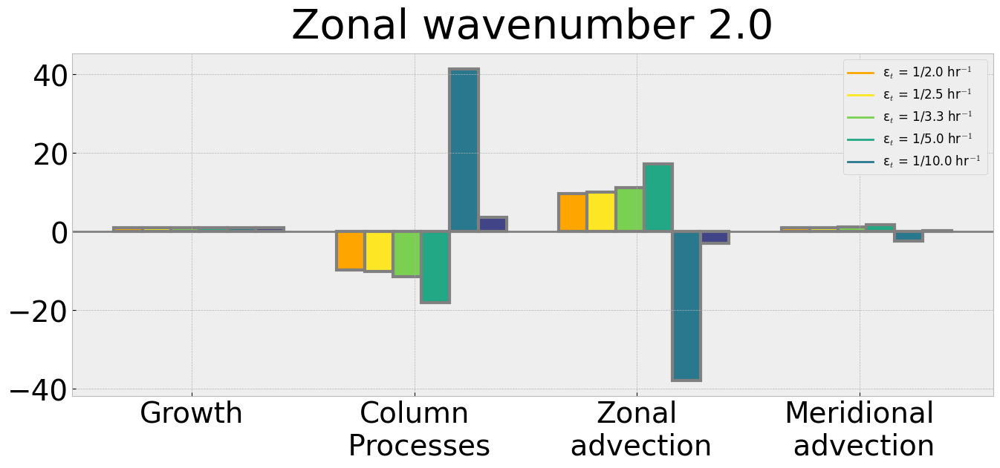

In [4616]:
plt.style.use('bmh')
fig = plt.figure(figsize=(16,6))
gs_main = gs.GridSpec(1, 1, figure=fig)
# gs_main.update(hspace=0.3)

bar_labels = [
    f"Growth",
    f"Column\n Processes" ,
    f"Zonal\n advection",
    f"Meridional\n advection",
]

process_colors = {
    'growth'                   : '#ffa500', 
    'propagation'              : '#ffa500', 
    'vertical advection'       : '#1cf91a',
    'omega'                    : '#1cf91a',
    'column processes'         : '#1cf91a',
    'zonal advection'          : '#0533ff',
    'u'                        : '#0533ff',
    'meridional advection'     : '#ff40ff', 
    'v'                        : '#ff40ff', 
    'column radiative heating' : '#4e2d8c',
    'Qr'                       : '#4e2d8c',
    'diffusion'                : '#A60628',
    'residual'                 : 'gray',
}

# ax = []
ax = fig.add_subplot(gs_main[0])
ax.set_title(f"Zonal wavenumber {solution_k[experiments[0]]}", pad=15)

grand_max = []
for variable in multi_experiment_growth_budgets.data_vars:
    grand_max.append(np.abs(multi_experiment_growth_budgets[variable].values.max()))

grand_max = np.max(grand_max)

normalized = True
width = 0.1275
multiplier = 0
bar_locations = np.arange(len(bar_labels))
bar_max = []
for exp in multi_experiment_growth_budgets["experiment"].values:
    offset = width * multiplier
    # if exp == experiments[0]:
    if not normalized:
        bar_values = [
                24*multi_experiment_growth_budgets['growth'].sel(experiment=exp),
                24*(multi_experiment_growth_budgets['omega'].sel(experiment=exp)+multi_experiment_growth_budgets['Qr'].sel(experiment=exp)),
                24*multi_experiment_growth_budgets['u'].sel(experiment=exp),
                24*multi_experiment_growth_budgets['v'].sel(experiment=exp),
            ]

    else:
        bar_values = [
                1,
                multi_experiment_growth_budgets['omega'].sel(experiment=exp).values/multi_experiment_growth_budgets['growth'].sel(experiment=exp).values,
                (multi_experiment_growth_budgets['u'].sel(experiment=exp).values+multi_experiment_growth_budgets['Qr'].sel(experiment=exp).values)/multi_experiment_growth_budgets['growth'].sel(experiment=exp).values,
                multi_experiment_growth_budgets['v'].sel(experiment=exp).values/multi_experiment_growth_budgets['growth'].sel(experiment=exp).values,
            ]
    bar_max.append(np.max(bar_values))
    # else:
    #     bar_values = [0,0,0,0,0]
    
    rects = ax.bar(
        bar_locations + offset, 
        bar_values, 
        label = exp, 
        color = colors[exp], 
        width = width,
        edgecolor='gray', 
        # edgecolor='#bcbcbc', 
        linewidth=3,
        align='center'
    )    
    # ax.bar_label(rects, padding=0.3)
    multiplier += 1

# if normalized:
#     ax.set_ylim(-10,20)
# else:
#     ax.set_ylim(-0.255, 0.2)
ax.axhline(y = 0, color='gray', lw=2)
# ax.set_ylabel(r'day$^{-1}$', rotation=0, labelpad=30)
ax.set_xticks(bar_locations+offset/len(bar_labels)+width, labels = bar_labels)

# leg = ax.legend(handles=[leg_names[0], leg_names[-4], leg_names[-3], leg_names[-2]], ncol=1, fontsize=14, loc="lower right")
leg = ax.legend(handles=leg_names[:6], ncol=1, fontsize=12, loc="upper right")
leg.get_frame().set_alpha(1)

plt.show()

## Combined structure/h plot

/tmp/ipykernel_2563720/1833087425.py:140: RuntimeWarning: divide by zero encountered in scalar divide
  r'ε$_t$ = ' + f"1/{1/(3600*epst[exp_name]):0.2f} " + r"$\text{hr}^{-1}$"


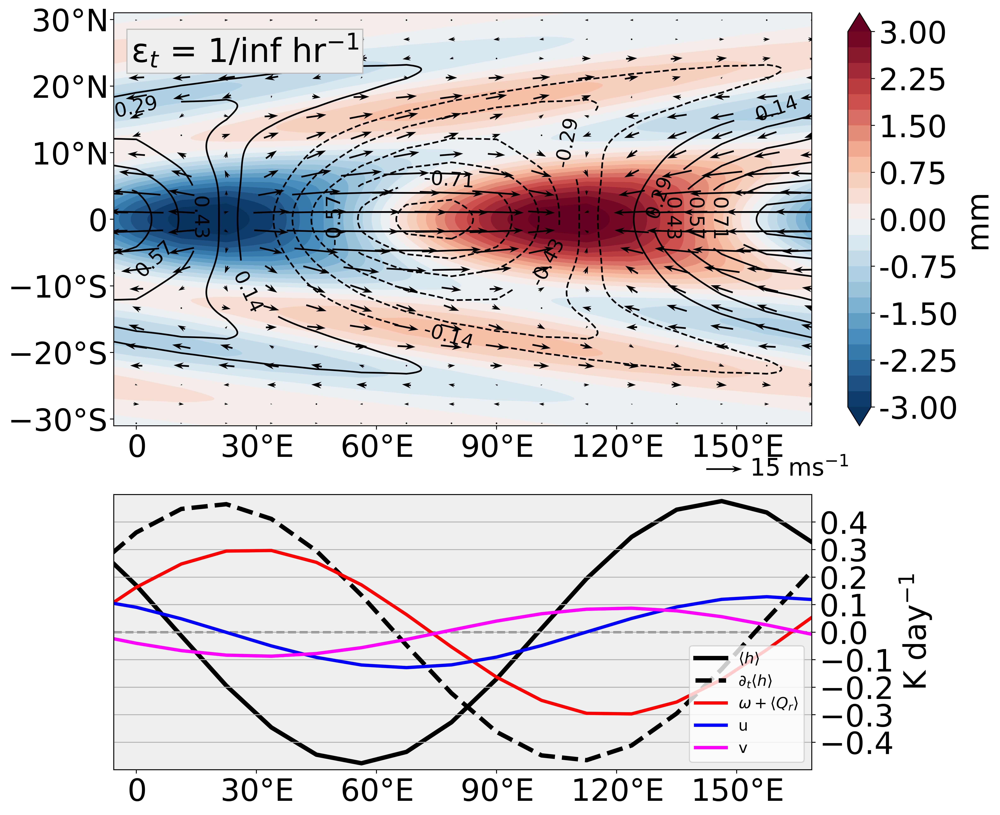

In [4965]:
# scale=5/u[exp_name].values.max()  # scale structures such that max zonal wind is 5 m/s
# scale=1/(qhat[exp_name].values.max()*delpg*cp/Lv)  # scale structures such that max moisture anomaly is 1 mm

exp_name = experiments[-1]

scale=1/(h[exp_name].values.max())  # scale structures such that max zonal wind is 5 m/s
u_norm=-np.copy(u[exp_name]*scale)
v_norm=-np.copy(v[exp_name]*scale)
# u_norm[:]=0.0
xarr=x[exp_name]*Re[exp_name]*1e-6
yarr=y[exp_name]*1e-6
xiint=1
# yiint=32
yiint=32

# moisture_x_max = np.argmax(That[exp_name].values[:, 1001//2])
moisture_x_max = np.argmax(h[exp_name].values[:, 1001//2])

if solution_k[exp_name] == 1:
    shifted_location = int(3*len(x[exp_name])/4)
elif solution_k[exp_name] == 2:
    shifted_location = int(7*len(x[exp_name])/8)
elif solution_k[exp_name] == 3:
    shifted_location = int(7*len(x[exp_name])/8)
# shifted_location = 28
roll = shifted_location - moisture_x_max
# roll = 0

rolled_That = np.roll(That[exp_name], axis=0, shift=roll)
rolled_qhat = np.roll(qhat[exp_name], axis=0, shift=roll)
rolled_u = np.roll(u_norm, axis=0, shift=roll)
rolled_v = np.roll(v_norm, axis=0, shift=roll)

X, Y = np.meshgrid(xarr, yarr, indexing='ij')

pcp_scale=24*delpg*cp/Lv ## convert to mm/d

# scale_vec=0.0025*0.25
# scale_vec=0.0025*0.5
# quiverkey_length=5.00/3e2

# plt.style.use('bmh')
plt.style.use('default')
plt.rcParams.update({'font.size':28})
fig = plt.figure(figsize=(12, 12), dpi=500)
gs_main = gs.GridSpec(2, 2, height_ratios=[3,2], width_ratios=[30,1], figure=fig)

# Update the bounds and spacing of the gs.GridSpec
gs_main.update(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.1)

# Add an axis for the initial condition
ax = []
ax.append(fig.add_subplot(gs_main[0,0]))
ax.append(fig.add_subplot(gs_main[1,0]))

cbar_ax = []
cbar_ax.append(fig.add_subplot(gs_main[0,1]))
# cbar_ax.append(fig.add_subplot(gs_main[1,1]))


CS=ax[0].contour(
    xarr,
    yarr,
    # rolled_x,
    # rolled_y,
    # That[exp_name].T*scale,
    rolled_That.T*scale,
    # levels=that_range*scale,
    # levels=15,
    levels=np.delete(np.linspace(-1, 1, 15), [15//2]),
    # levels=np.delete(np.linspace(-0.2, 0.2, 15), [15//2]),
    colors='black'
)
ax[0].clabel(CS, CS.levels, inline=True, fmt='%.2f', fontsize=18)

CT = ax[0].contourf(
    xarr,
    yarr,
    # rolled_x,
    # rolled_y,
    rolled_qhat.T*scale*delpg*cp/Lv,
    # levels=qhat_range*scale*0.5,
    # levels=np.linspace(-1,1,30),
    levels=30,
    extend='both',
    cmap=Ahmed_cmap
)

CB=plt.colorbar(
    CT, 
    cax=cbar_ax[0],
    label='mm',
    orientation='vertical',
    format="%.2f",
    # ticks=matplotlib.ticker.MultipleLocator(0.2))
)

vector_scale = 15
key_length = 1
q=ax[0].quiver(
    X[::xiint,::yiint],
    Y[::xiint,::yiint],
    rolled_u[::xiint,::yiint],
    rolled_v[::xiint,::yiint],
    angles='xy',
    scale_units='xy',
    units='xy',
    scale=vector_scale,
    pivot='middle',
    # pivot='tail',
    alpha=1.0,
    color='black',
    headwidth=4,
    headlength=6,
    headaxislength=4.5,
    zorder=10
)


ax[0].quiverkey(
    q, 
    X=0.9,
    # Y=1.025,
    Y=-0.105,
    U=vector_scale*key_length,
    label=f"{vector_scale*key_length}" + r' $\mathrm{ms}^{-1}$',
    labelpos='E',
    color='black',
    fontproperties={'size': '22'},
    coordinates='axes'
)

ax[0].text(
        # x=38.9557489*(5/360),
        # y=29*111e-3,
        x=0.025,
        y=0.95,
        s=(
            # r'ε$_q$ = ' + f"{3600*epsq[exp_name]:0.3f}, " 
            r'ε$_t$ = ' + f"1/{1/(3600*epst[exp_name]):0.2f} " + r"$\text{hr}^{-1}$"
            # + r'ε$_t$/ε$_q$ = ' + f"{epst[exp_name]/epsq[exp_name]:0.2f}"
        ),
        bbox={'fc':'#eeeeee', 'ec':'#bcbcbc'},
        ha='left',
        va='top',
        fontsize=30,
        zorder=11,
        transform=ax[0].transAxes
    )
ax[0].grid(False)

# Calculate budget terms
zonal_advection_structure = 3600*(sigma_x[exp_name]/delpg)*scale*u[exp_name].values
meridional_advection_structure = 3600*(sigma_y[exp_name]/delpg)*scale*y[exp_name].values*v[exp_name].values
vertical_advection_structure = 3600*(0.25*Ms[exp_name]/delpg)*scale*omega[exp_name].values
convective_heating_structure = 3600*(epsq[exp_name]*scale*qhat[exp_name].values - epst[exp_name]*scale*That[exp_name].values)
radiative_heating_structure = r[exp_name]*convective_heating_structure
column_process_structure = vertical_advection_structure + radiative_heating_structure

# Average meridionally over the near-equatorial region
near_equatorial_zonal_advection_structure = np.mean(zonal_advection_structure[:, near_equatorial_region], axis=1)
near_equatorial_meridional_advection_structure = np.mean(meridional_advection_structure[:, near_equatorial_region], axis=1)
near_equatorial_column_process_structure = np.mean(column_process_structure[:, near_equatorial_region], axis=1)
near_equatorial_h = np.mean(h[exp_name].values[:, near_equatorial_region], axis=1)
near_equatorial_h_tendency = np.mean(h_tendency[exp_name].values[:, near_equatorial_region], axis=1)

scale=1/(near_equatorial_h.max())

# plt.style.use('bmh')
# plt.rcParams.update({'font.size':28})
ax[1].plot(
    xarr, 
    np.roll(
        near_equatorial_h*scale, 
        shift=roll,
        axis=0
    ), 
    color='black',
    ls='-',
    label=r'$\langle h \rangle$',
    lw=4
)

ax[1].axhline(y=0, ls='--', color='gray', lw=2)
ax[1].set_ylim(-1.05,1.05)
ax[1].set_yticks([])
ax[1].grid(False)

ax2 = ax[1].twinx()
# ax2.set_facecolor('#eeeeee')
# ax2.set_edgecolor('#bcbcbc')
ax2.plot(
    [],
    color='k',
    lw=4,
    label=r'$\langle h \rangle$'
)

ax2.plot(
    xarr, 
    np.roll(
        24*near_equatorial_h_tendency*scale, 
        shift=roll,
        axis=0
    ), 
    color='black',
    label=r'$\partial_{t} \langle h \rangle$',
    lw=4,
    ls='--'
)
# ax2.plot(
#     [],
#     color='k',
#     lw=4,
#     label=r'$\partial_{t} \langle h \rangle$',
#     ls='--'
# )
ax2.plot(
    xarr, 
    np.roll(
        24*near_equatorial_column_process_structure, 
        shift=roll,
        axis=0
    ), 
    color='red', 
    ls='-',
    label=r'$\omega + \langle Q_{r} \rangle$',
    lw=3
)
ax2.plot(
    xarr, 
    np.roll(
        24*near_equatorial_zonal_advection_structure, 
        shift=roll,
        axis=0
    ), 
    color='blue', 
    ls='-',
    label=r'u',
    lw=3
)
ax2.plot(
    xarr, 
    np.roll(
        24*near_equatorial_meridional_advection_structure, 
        shift=roll,
        axis=0
    ), 
    color='magenta', 
    ls='-',
    label=r'v',
    lw=3
)
ax2.set_ylim(-0.5, 0.5)
ax2.set_yticks([-0.4, -0.3, -0.2,-0.1,0.0,0.1,0.2, 0.3, 0.4])
ax2.set_ylabel(r'K day$^{-1}$')
ax2.legend(fontsize=14, loc='lower right')
ax2.grid(True)
ax[1].set_facecolor('#eeeeee')
ax2.set_facecolor('#eeeeee')

# Format axes
for index, _ in enumerate(ax):
    
    ax[index].tick_params(which='both')
    # ax[index].set_xlim([19.47787445, 38.9557489])
    # xlocs=np.arange(180,390,30)*2*np.pi*Re[exp_name]*1e-6/(360)
    if solution_k[exp_name] == 1:
        ax[index].set_xlim([0, 38.9557489])
        xlocs=np.arange(0,390,60)*2*np.pi*Re[exp_name]*1e-6/(360)
    elif solution_k[exp_name] == 2:
        ax[index].set_xlim([38.9557489/2, 38.9557489])
        xlocs=np.arange(180,390,30)*2*np.pi*Re[exp_name]*1e-6/(360)
    elif solution_k[exp_name] == 3:
        ax[index].set_xlim([2*38.9557489/3, 38.9557489])
        xlocs=np.arange(240,390,30)*2*np.pi*Re[exp_name]*1e-6/(360)
    xmajorLocator = matplotlib.ticker.FixedLocator(locs=xlocs) 
    xmajorFormatter = matplotlib.ticker.FuncFormatter(xtolon)
    
    ax[index].xaxis.set_major_locator( xmajorLocator )
    ax[index].xaxis.set_major_formatter( xmajorFormatter )

    if index == 0:
        ax[index].set_ylim(-31*111e-3,31*111e-3)
        # ax[index].set_ylim(10*111e-3,31*111e-3)
        ylocs=np.arange(-40,50.0,10.0)*111e-3
        # ylocs=np.arange(-40,50.0,5.0)*111e-3
        ymajorLocator = matplotlib.ticker.FixedLocator(locs=ylocs) 
        ymajorFormatter = matplotlib.ticker.FuncFormatter(ytolat)
        
        ax[index].yaxis.set_major_locator( ymajorLocator )
        ax[index].yaxis.set_major_formatter( ymajorFormatter )
        
    ax[index].set_aspect('auto')

plt.show()
# plt.savefig(
#     (
#         f"./figures/model_{model_type[exp_name]}_k={solution_k[exp_name]:0.2f}"
#         + f"_epsq={epsq[exp_name]*3600:0.3f}_epst={epst[exp_name]*3600:0.3f}"
#         + f"_joint-horizontal-structure-and-budget-terms.png"
#     ), 
#     bbox_inches='tight',
#     dpi=350
# )

In [4926]:
def calculate_phase_angle(signal_1, signal_2, units='rad'):
    if units == 'deg':
        conversion = 180/np.pi
    else:
        conversion = 1
    return conversion*np.arccos(np.dot(signal_1, signal_2) / (np.linalg.norm(signal_1)*np.linalg.norm(signal_2)))

## Calculate phase angle

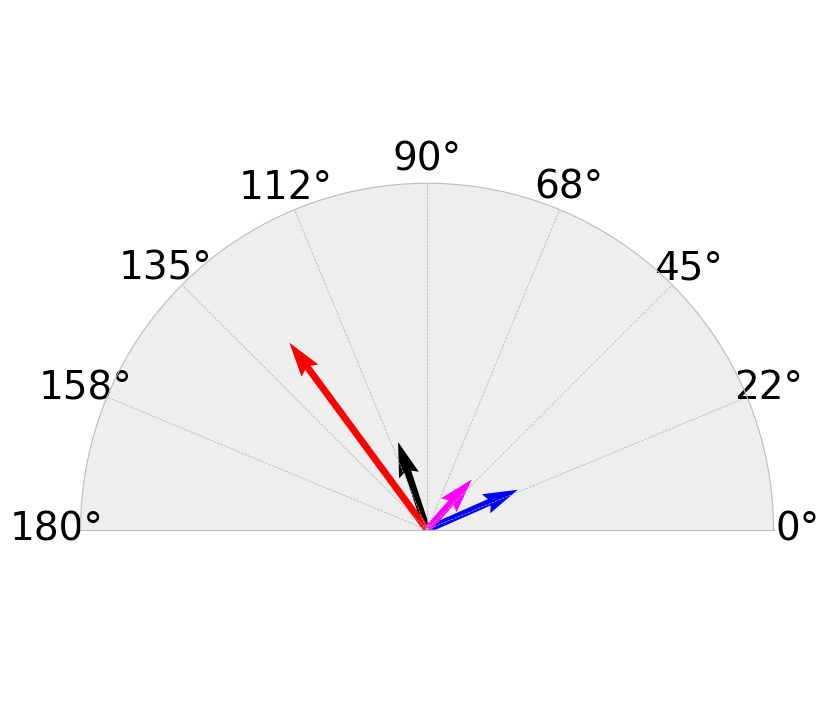

In [4971]:
htend_phase = {}
zonal_phase = {}
meridional_phase = {}
column_phase = {}

htend_vec = {}
zonal_vec = {}
meridional_vec = {}
column_vec = {}

for exp_name in experiments:

    scale=1/(h[exp_name].values.max())
    # Calculate budget terms
    zonal_advection_structure = 3600*(sigma_x[exp_name]/delpg)*scale*u[exp_name].values
    meridional_advection_structure = 3600*(sigma_y[exp_name]/delpg)*scale*y[exp_name].values*v[exp_name].values
    vertical_advection_structure = 3600*(0.25*Ms[exp_name]/delpg)*scale*omega[exp_name].values
    convective_heating_structure = 3600*(epsq[exp_name]*scale*qhat[exp_name].values - epst[exp_name]*scale*That[exp_name].values)
    radiative_heating_structure = r[exp_name]*convective_heating_structure
    column_process_structure = vertical_advection_structure + radiative_heating_structure
    
    # Average meridionally over the near-equatorial region
    near_equatorial_zonal_advection_structure = np.mean(zonal_advection_structure[:, near_equatorial_region], axis=1)
    near_equatorial_meridional_advection_structure = np.mean(meridional_advection_structure[:, near_equatorial_region], axis=1)
    near_equatorial_column_process_structure = np.mean(column_process_structure[:, near_equatorial_region], axis=1)
    near_equatorial_h = np.mean(h[exp_name].values[:, near_equatorial_region], axis=1)
    near_equatorial_h_tendency = np.mean(h_tendency[exp_name].values[:, near_equatorial_region], axis=1)

    htend_phase[exp_name] = calculate_phase_angle(near_equatorial_h, near_equatorial_h_tendency, 'rad')
    zonal_phase[exp_name] = calculate_phase_angle(near_equatorial_h, near_equatorial_zonal_advection_structure, 'rad')
    meridional_phase[exp_name] = calculate_phase_angle(near_equatorial_h, near_equatorial_meridional_advection_structure, 'rad')
    column_phase[exp_name] = calculate_phase_angle(near_equatorial_h, near_equatorial_column_process_structure, 'rad')
    
    htend_vec[exp_name] = np.array([
        np.linalg.norm(near_equatorial_h_tendency)*np.cos(htend_phase[exp_name]), 
        np.linalg.norm(near_equatorial_h_tendency)*np.sin(htend_phase[exp_name])
    ])
    
    zonal_vec[exp_name] = np.array([
        np.linalg.norm(near_equatorial_zonal_advection_structure)*np.cos(zonal_phase[exp_name]), 
        np.linalg.norm(near_equatorial_zonal_advection_structure)*np.sin(zonal_phase[exp_name])
    ])
    
    meridional_vec[exp_name] = np.array([
        np.linalg.norm(near_equatorial_meridional_advection_structure)*np.cos(meridional_phase[exp_name]), 
        np.linalg.norm(near_equatorial_meridional_advection_structure)*np.sin(meridional_phase[exp_name])
    ])
    
    column_vec[exp_name] = np.array([
        np.linalg.norm(near_equatorial_column_process_structure)*np.cos(column_phase[exp_name]), 
        np.linalg.norm(near_equatorial_column_process_structure)*np.sin(column_phase[exp_name])
    ])

plt.style.use('bmh')
fig = plt.figure(figsize=(9,9))
ax = fig.add_subplot(111, projection='polar')

quiver_scale = 0.15
vec_width = 0.01
alpha_val = 0.5
# ax.quiver([0], [0], htend_vec[experiments[0]][0], htend_vec[experiments[0]][1], color='black', scale=quiver_scale, alpha=alpha_val, width=vec_width, zorder=10)
# ax.quiver([0], [0], zonal_vec[experiments[0]][0], zonal_vec[experiments[0]][1], color='blue', scale=quiver_scale, alpha=alpha_val, width=vec_width, zorder=10)
# ax.quiver([0], [0], column_vec[experiments[0]][0], column_vec[experiments[0]][1], color='red', scale=quiver_scale, alpha=alpha_val, width=vec_width, zorder=10)
# ax.quiver([0], [0], meridional_vec[experiments[0]][0], meridional_vec[experiments[0]][1], color='magenta', scale=quiver_scale, alpha=alpha_val, width=vec_width, zorder=10)

ax.quiver([0], [0], htend_vec[experiments[-1]][0], htend_vec[experiments[-1]][1], color='black', scale=quiver_scale, alpha=1, width=vec_width)
ax.quiver([0], [0], zonal_vec[experiments[-1]][0], zonal_vec[experiments[-1]][1], color='blue', scale=quiver_scale, alpha=1, width=vec_width)
ax.quiver([0], [0], column_vec[experiments[-1]][0], column_vec[experiments[-1]][1], color='red', scale=quiver_scale, alpha=1, width=vec_width)
ax.quiver([0], [0], meridional_vec[experiments[-1]][0], meridional_vec[experiments[-1]][1], color='magenta', scale=quiver_scale, alpha=1, width=vec_width)


ax.set_rmin(0)
# ax.set_rmax(1)
ax.set_thetalim(0, np.pi)
# Set the direction of 0 degrees to be north (default is east)
ax.set_theta_zero_location('E')

# Set the direction of rotation to be clockwise (default is counter-clockwise)
ax.set_theta_direction(1)

# ax.set_xticks([0, np.pi/4, np.pi/2, 3*np.pi/4, np.pi])
ax.set_xticks(np.arange(0, np.pi+np.pi/8, np.pi/8))
ax.set_rticks([])
ax.tick_params(axis='both', pad=10)

# Set the polar grid
ax.grid(True)

# Show the plot
plt.show()

In [4979]:
[180/np.pi*val for val in htend_phase.values()]

[80.68786225481904,
 81.77485190908257,
 83.4333591311977,
 86.18511000532656,
 91.53248771884404,
 108.28882031228726]

In [4891]:
from dataclasses import dataclass
@dataclass
class Experiment():
    model_type : str
    epsq : float

@dataclass
class ModelAExperiment(Experiment):
    epst : float

@dataclass
class ModelASolution(ModelAExperiment):
    k : float
    u : np.ndarray

    def normalize(self)

In [4900]:
obj_list = []
obj_list.append(ModelASolution(model_type = 'A', epsq=1/(6*3600), epst=1/(2*3600), k = 2.0, u = u[exp_name]))

In [4907]:
setattr(obj_list[0], 'epst', 2*getattr(obj_list[0], 'epst'))

In [4909]:
obj_list[0].epst*3600

1.0

In [4614]:
for e in experiments:
    print(np.sqrt(htend_vec[e][0]**2 + htend_vec[e][1]**2))

0.007720769071089706
0.008507381292834588
0.009827288870265748
0.011453737495661845
0.014303226077661855
0.01937503956523694


In [4568]:
zonal_vec
column_vec

{'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=6.70_k=2.00_model=A': array([-0.00687168, -0.01602468]),
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=7.50_k=2.00_model=A': array([-0.00753735, -0.01757702]),
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=8.60_k=2.00_model=A': array([0.01190246, 0.01805465]),
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=10.00_k=2.00_model=A': array([0.0135291 , 0.02052206]),
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.100_cp=13.00_k=2.00_model=A': array([0.00958403, 0.02363376]),
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.000_cp=16.00_k=2.00_model=A': array([-0.00600438, -0.01400215])}

In [ ]:
plt.style.use('default')
plt.rcParams.update({'font.size':28})

# scale=5/u[exp_name].values.max()  # scale structures such that max zonal wind is 5 m/s
# scale=1/(qhat[exp_name].values.max()*delpg*cp/Lv)  # scale structures such that max moisture anomaly is 1 mm

exp_name = experiments[0]

scale=1/(h[exp_name].values.max())  # scale structures such that max zonal wind is 5 m/s
u_norm=-np.copy(u[exp_name]*scale)
v_norm=-np.copy(v[exp_name]*scale)
# u_norm[:]=0.0
xarr=x[exp_name]*Re[exp_name]*1e-6
yarr=y[exp_name]*1e-6
xiint=1
# yiint=32
yiint=32

# moisture_x_max = np.argmax(That[exp_name].values[:, 1001//2])
moisture_x_max = np.argmax(h[exp_name].values[:, 1001//2])

if solution_k[exp_name] == 1:
    shifted_location = int(3*len(x[exp_name])/4)
elif solution_k[exp_name] == 2:
    shifted_location = int(7*len(x[exp_name])/8)
elif solution_k[exp_name] == 3:
    shifted_location = int(7*len(x[exp_name])/8)
# shifted_location = 28
roll = shifted_location - moisture_x_max

rolled_That = np.roll(That[exp_name], axis=0, shift=roll)
rolled_qhat = np.roll(qhat[exp_name], axis=0, shift=roll)
rolled_u = np.roll(u_norm, axis=0, shift=roll)
rolled_v = np.roll(v_norm, axis=0, shift=roll)

X, Y = np.meshgrid(xarr, yarr, indexing='ij')

pcp_scale=24*delpg*cp/Lv ## convert to mm/d

# scale_vec=0.0025*0.25
# scale_vec=0.0025*0.5
# quiverkey_length=5.00/3e2

fig = plt.figure(figsize=(14.5, 16.0), dpi=500)
gs_main = gs.GridSpec(2, 2, height_ratios = [1,1], width_ratios=[30,1], figure=fig)

# Update the bounds and spacing of the gs.GridSpec
gs_main.update(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.1)

# Add an axis for the initial condition
ax = []
ax.append(fig.add_subplot(gs_main[0,0]))
ax.append(fig.add_subplot(gs_main[1,0]))

cbar_ax = []
cbar_ax.append(fig.add_subplot(gs_main[0,1]))
cbar_ax.append(fig.add_subplot(gs_main[1,1]))
CS=ax[0].contour(
    xarr,
    yarr,
    # rolled_x,
    # rolled_y,
    # That[exp_name].T*scale,
    rolled_That.T*scale,
    # levels=that_range*scale,
    # levels=15,
    # levels=np.delete(np.linspace(-1, 1, 15), [15//2]),
    levels=np.delete(np.linspace(-0.2, 0.2, 15), [15//2]),
    colors='black'
)
ax[0].clabel(CS, CS.levels, inline=True, fmt='%.2f', fontsize=18)

CT = ax[0].contourf(
    xarr,
    yarr,
    # rolled_x,
    # rolled_y,
    rolled_qhat.T*scale*delpg*cp/Lv,
    # levels=qhat_range*scale*0.5,
    # levels=np.linspace(-1,1,30),
    levels=30,
    extend='both',
    cmap=Ahmed_cmap
)

CB=plt.colorbar(
    CT, 
    cax=cbar_ax[0],
    label='mm',
    orientation='vertical',
    format="%.2f",
    # ticks=matplotlib.ticker.MultipleLocator(0.2))
)

vector_scale = 15
key_length = 1
q=ax[0].quiver(
    X[::xiint,::yiint],
    Y[::xiint,::yiint],
    rolled_u[::xiint,::yiint],
    rolled_v[::xiint,::yiint],
    angles='xy',
    scale_units='xy',
    units='xy',
    scale=vector_scale,
    pivot='middle',
    # pivot='tail',
    alpha=1.0,
    color='black',
    headwidth=4,
    headlength=6,
    headaxislength=4.5,
    zorder=10
)


ax[0].quiverkey(
    q, 
    X=0.9,
    # Y=1.025,
    Y=-0.115,
    U=vector_scale*key_length,
    label=f"{vector_scale*key_length}" + r' $\mathrm{ms}^{-1}$',
    labelpos='E',
    color='black',
    fontproperties={'size': '22'},
    coordinates='axes'
)

ax[0].text(
        # x=38.9557489*(5/360),
        # y=29*111e-3,
        x=0.025,
        y=0.95,
        s=(
            # r'ε$_q$ = ' + f"{3600*epsq[exp_name]:0.3f}, " 
            r'ε$_t$ = ' + f"1/{1/(3600*epst[exp_name]):0.2f} " + r"$\text{hr}^{-1}$"
            # + r'ε$_t$/ε$_q$ = ' + f"{epst[exp_name]/epsq[exp_name]:0.2f}"
        ),
        bbox={'fc':'#eeeeee', 'ec':'#bcbcbc'},
        ha='left',
        va='top',
        fontsize=30,
        zorder=11,
        transform=ax[0].transAxes
    )

/tmp/ipykernel_2563720/3230447145.py:136: RuntimeWarning: divide by zero encountered in scalar divide
  r'ε$_t$ = ' + f"1/{1/(3600*epst[exp_name]):0.2f} " + r"$\text{hr}^{-1}$"


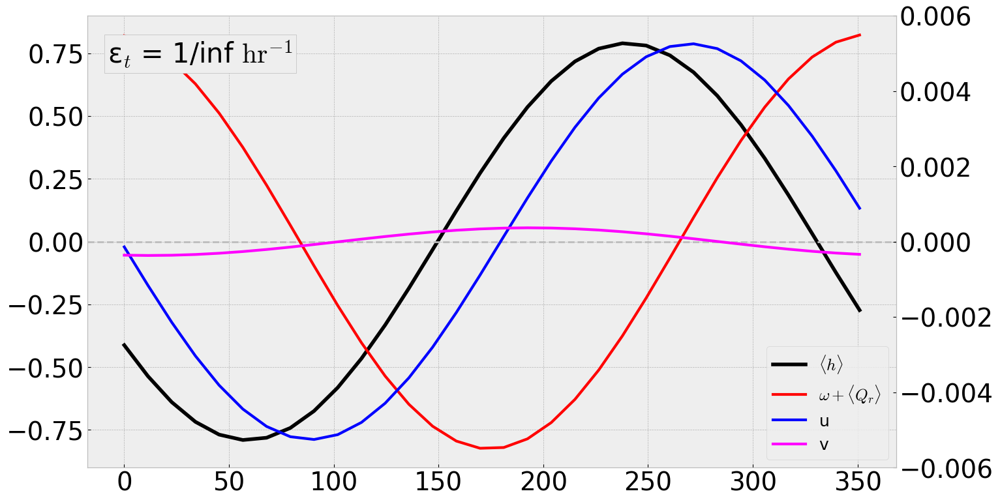

In [4316]:
experiment_linestyles = {}
experiment_linestyles[experiments[0]] = '-'
experiment_linestyles[experiments[-1]] = '-'

plt.style.use('bmh')
plt.figure(figsize=(16,9))
# for index, exp_name in enumerate([experiments[-1]]):

exp_name = experiments[-1]
scale=1/(h[exp_name].max()).values

# Calculate budget terms
zonal_advection_structure = 3600*(sigma_x[exp_name]/delpg)*scale*u[exp_name].values
meridional_advection_structure = 3600*(sigma_y[exp_name]/delpg)*scale*y[exp_name].values*v[exp_name].values
vertical_advection_structure = 3600*(0.25*Ms[exp_name]/delpg)*scale*omega[exp_name].values
convective_heating_structure = 3600*(epsq[exp_name]*scale*qhat[exp_name].values - epst[exp_name]*scale*That[exp_name].values)
radiative_heating_structure = r[exp_name]*convective_heating_structure
column_process_structure = vertical_advection_structure + radiative_heating_structure

# Average meridionally over the near-equatorial region
near_equatorial_zonal_advection_structure = np.mean(zonal_advection_structure[:, near_equatorial_region], axis=1)
near_equatorial_meridional_advection_structure = np.mean(meridional_advection_structure[:, near_equatorial_region], axis=1)
near_equatorial_column_process_structure = np.mean(column_process_structure[:, near_equatorial_region], axis=1)
near_equatorial_h = np.mean(h[exp_name].values[:, near_equatorial_region], axis=1)
near_equatorial_h_tendency = np.mean(h_tendency[exp_name].values[:, near_equatorial_region], axis=1)

# # Normalize the values
# normalized_zonal_advection = near_equatorial_zonal_advection_structure/np.max(near_equatorial_zonal_advection_structure)
# normalized_column_process = near_equatorial_column_process_structure/np.max(near_equatorial_column_process_structure)
# normalized_h = near_equatorial_h/np.max(near_equatorial_h)
# normalized_h_tendency = near_equatorial_h_tendency/np.max(near_equatorial_h_tendency)


shifted_location = int(2*len(x[exp_name])/3)
# shifted_location = 0
# roll = shifted_location - np.argmax(normalized_h_tendency)
roll = shifted_location - np.argmax(near_equatorial_h)
# if index == 1:
#     roll += 0

# plt.plot(
#     xarr/111e-3, 
#     np.roll(
#         normalized_h_tendency, 
#         shift=roll,
#         axis=0
#     ), 
#     color='orange',
#     ls=experiment_linestyles[exp_name],
#     label=r'$\partial_{t} \langle h \rangle, \varepsilon_{t}=$' + f"1/{1/(3600*epst[exp_name]):0.2f}" + r' $\text{hr}^{-1}$'
# )

plt.plot(
    xarr/111e-3, 
    np.roll(
        near_equatorial_h*scale, 
        shift=roll,
        axis=0
    ), 
    color='black',
    ls=experiment_linestyles[exp_name],
    label=r'$\langle h \rangle$',
    lw=4
)
plt.axhline(y=0, ls='--', color='#bcbcbc', lw=2)
plt.ylim(-0.9,0.9)

ax2 = plt.twinx()
ax2.plot(
    [],
    color='k',
    lw=4,
    label=r'$\langle h \rangle$'
)
ax2.plot(
    xarr/111e-3, 
    np.roll(
        near_equatorial_column_process_structure, 
        shift=roll,
        axis=0
    ), 
    color='red', 
    ls=experiment_linestyles[exp_name],
    label=r'$\omega + \langle Q_{r} \rangle$',
    lw=3
)
ax2.plot(
    xarr/111e-3, 
    np.roll(
        near_equatorial_zonal_advection_structure, 
        shift=roll,
        axis=0
    ), 
    color='blue', 
    ls=experiment_linestyles[exp_name],
    label=r'u',
    lw=3
)
ax2.plot(
    xarr/111e-3, 
    np.roll(
        near_equatorial_meridional_advection_structure, 
        shift=roll,
        axis=0
    ), 
    color='magenta', 
    ls=experiment_linestyles[exp_name],
    label=r'v',
    lw=3
)

ax2.set_ylim(-0.006, 0.006)

# if solution_k[exp_name] == 1:
#     plt.xlim([0, 38.9557489])
#     xlocs=np.arange(45,390,45)*2*np.pi*Re[exp_name]*1e-6/(360)
# elif solution_k[exp_name] == 2:
#     plt.xlim([38.9557489/2, 38.9557489])
#     xlocs=np.arange(180,390,30)*2*np.pi*Re[exp_name]*1e-6/(360)
# elif solution_k[exp_name] == 3:
#     plt.xlim([2*38.9557489/3, 38.9557489])
#     xlocs=np.arange(240,390,30)*2*np.pi*Re[exp_name]*1e-6/(360)
# xmajorLocator = matplotlib.ticker.FixedLocator(locs=xlocs) 
# xmajorFormatter = matplotlib.ticker.FuncFormatter(xtolon)

# plt.gca().xaxis.set_major_locator( xmajorLocator )
# plt.gca().xaxis.set_major_formatter( xmajorFormatter )

plt.text(
    # x=38.9557489*(5/360),
    # y=29*111e-3,
    x=0.025,
    y=0.95,
    s=(
        # r'ε$_q$ = ' + f"{3600*epsq[exp_name]:0.3f}, " 
        r'ε$_t$ = ' + f"1/{1/(3600*epst[exp_name]):0.2f} " + r"$\text{hr}^{-1}$"
        # + r'ε$_t$/ε$_q$ = ' + f"{epst[exp_name]/epsq[exp_name]:0.2f}"
    ),
    bbox={'fc':'#eeeeee', 'ec':'#bcbcbc'},
    ha='left',
    va='top',
    fontsize=30,
    zorder=11,
    transform=plt.gca().transAxes
)
ax2.grid(False)

plt.legend(fontsize=18, loc='best')
plt.show()

In [4308]:
print(np.max(near_equatorial_column_process_structure))
print(np.max(near_equatorial_zonal_advection_structure))

0.005487967166994093
0.005254929894162852


In [4138]:
hC_phase_angle = {}
hu_phase_angle = {}

# for index, exp_name in enumerate([experiments[0], experiments[-1]]):
for index, exp_name in enumerate(experiments):
    
    zonal_advection_structure = 3600*(sigma_x[exp_name]/delpg)*u[exp_name].values
    vertical_advection_structure = 3600*(0.25*Ms[exp_name]/delpg)*omega[exp_name].values
    convective_heating_structure = 3600*(epsq[exp_name]*qhat[exp_name].values - epst[exp_name]*That[exp_name].values)
    radiative_heating_structure = r[exp_name]*convective_heating_structure
    column_process_structure = vertical_advection_structure + radiative_heating_structure

    near_equatorial_zonal_advection_structure = np.mean(zonal_advection_structure[:, near_equatorial_region], axis=1)
    near_equatorial_column_process_structure = np.mean(column_process_structure[:, near_equatorial_region], axis=1)
    near_equatorial_h = np.mean(h[exp_name].values[:, near_equatorial_region], axis=1)
    near_equatorial_h_tendency = np.mean(h_tendency[exp_name].values[:, near_equatorial_region], axis=1)
    
    normalized_zonal_advection = near_equatorial_zonal_advection_structure/np.max(near_equatorial_zonal_advection_structure)
    normalized_h = near_equatorial_h/np.max(near_equatorial_h)
    normalized_h_tendency = near_equatorial_h_tendency/np.max(near_equatorial_h_tendency)
    normalized_column_process = near_equatorial_column_process_structure/np.max(near_equatorial_column_process_structure)

    hC_phase_angle[exp_name] = (
        (x[exp_name]*Re[exp_name]/111e3)[np.argmin(normalized_h)]
        - (x[exp_name]*Re[exp_name]/111e3)[np.argmin(normalized_column_process)]
    ).values

    hu_phase_angle[exp_name] = (
            (x[exp_name]*Re[exp_name]/111e3)[np.argmin(normalized_h)]
            - (x[exp_name]*Re[exp_name]/111e3)[np.argmin(normalized_zonal_advection)]
        ).values

In [4140]:
hu_phase_angle

{'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=7.70_k=1.00_model=A': array(-22.64210922),
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=8.50_k=1.00_model=A': array(-22.64210922),
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=9.60_k=1.00_model=A': array(-33.96316382),
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=11.00_k=1.00_model=A': array(-33.96316382),
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.100_cp=14.00_k=1.00_model=A': array(-33.96316382),
 'meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.000_cp=18.00_k=1.00_model=A': array(-33.96316382)}

In [4128]:
print((x[experiments[0]]*Re[experiments[0]]/111e3)[9] - (x[experiments[0]]*Re[experiments[0]]/111e3)[11])
print((x[experiments[-1]]*Re[experiments[-1]]/111e3)[17] - (x[experiments[-1]]*Re[experiments[-1]]/111e3)[20])

<xarray.Variable ()>
array(-22.64210922)
<xarray.Variable ()>
array(-33.96316382)


In [4016]:
normalized_h_tendency

<xarray.Variable (htendDim1: 32)>
array([ 0.01622815,  0.29179755,  0.55615333,  0.79913644,  1.0114092 ,
        1.18481406,  1.31268719,  1.39011448,  1.41412045,  1.38378257,
        1.30026669,  1.1667823 ,  0.98845912,  0.77215001,  0.52616761,
        0.25996488, -0.01622815, -0.29179755, -0.55615333, -0.79913644,
       -1.0114092 , -1.18481406, -1.31268719, -1.39011448, -1.41412045,
       -1.38378257, -1.30026669, -1.1667823 , -0.98845912, -0.77215001,
       -0.52616761, -0.25996488])

## Plot horizontal structure of growth budget terms

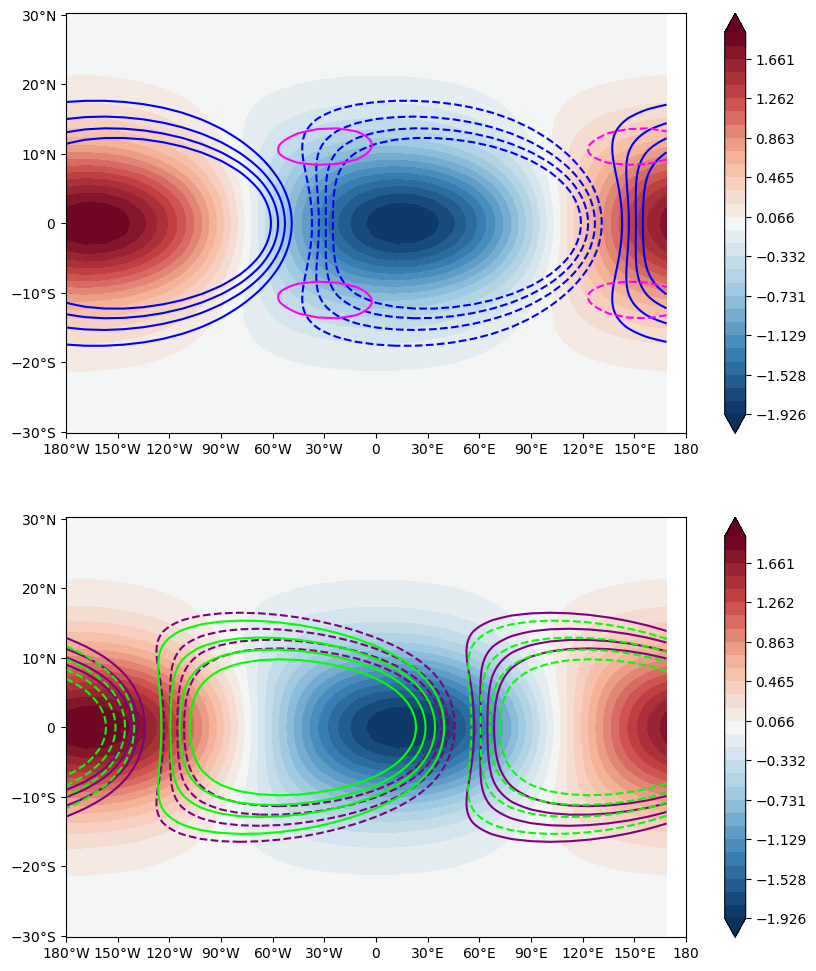

In [3054]:
exp = experiments[-1]
# h = qhat[exp].values + That[exp].values
h_levels = np.linspace(-np.max(np.abs(h[exp])), np.max(np.abs(h[exp])), 30)

plt.style.use('default')
# [fig, ax] = plt.subplots(2, 1, figsize=(16,12))
[fig, ax] = plt.subplots(2, 1, figsize=(10,12))

# Plot <h>
Ch = ax[0].contourf(
    x[exp].values*1e-3*Re[exp_name],
    y[exp].values*1e-3,
    h[exp].T, 
    cmap=Ahmed_cmap, 
    levels=h_levels, 
    extend='both'
)
cbar = plt.colorbar(Ch)
# cbar.set_ticks(np.arange(-1, 1.25, 0.25))

# Plot σ_x * u_1
ax[0].contour(
    x[exp].values*1e-3*Re[exp_name],
    y[exp].values*1e-3,
    3600/delpg*sigma_x[exp]*u[exp].T, 
    colors='blue', 
    levels=np.delete(np.linspace(-4e-3, 4e-3, 10), [4,5])
)

# Plot -σ_y * y * u_1
ax[0].contour(
    x[exp].values*1e-3*Re[exp_name],
    y[exp].values*1e-3,
    -3600/delpg*sigma_y[exp]*(y[exp].values*v[exp].values).T, 
    colors='magenta', 
    levels=np.delete(np.linspace(-4e-3, 4e-3, 10), [4,5])
)

# Format the axes
xlocs=np.arange(0,390,30)*2*np.pi*Re[exp_name]*1e-3/(360)
xmajorLocator = matplotlib.ticker.FixedLocator(locs=xlocs) 
xmajorFormatter = matplotlib.ticker.FuncFormatter(xtolon)

ax[0].xaxis.set_major_locator( xmajorLocator )
ax[0].xaxis.set_major_formatter( xmajorFormatter )
# ax[0].set_xlim(0, 180*2*np.pi*Re[exp_name]*1e-3/(360))
# ax[0].set_xlim(0, 360*2*np.pi*Re[exp_name]*1e-3/(360))
ax[0].set_xlim(0, 360*2*np.pi*Re[exp_name]*1e-3/(360)/solution_k[exp])


ylocs=np.arange(-30,40.0,10.0)*111
# ylocs=np.arange(-35,45.0,10.0)*111
ymajorLocator = matplotlib.ticker.FixedLocator(locs=ylocs) 
ymajorFormatter = matplotlib.ticker.FuncFormatter(ytolat)

ax[0].yaxis.set_major_locator( ymajorLocator )
ax[0].yaxis.set_major_formatter( ymajorFormatter )
ax[0].set_ylim(-30.25*111, 30.25*111)

ax[0].set_aspect('auto')


#### Second plot
# Plot <h>
Ch = ax[1].contourf(
    x[exp].values*1e-3*Re[exp_name],
    y[exp].values*1e-3,
    h[exp].T, 
    cmap=Ahmed_cmap, 
    levels=h_levels, 
    extend='both'
)
cbar = plt.colorbar(Ch)
# cbar.set_ticks(np.arange(-1, 1.25, 0.25))

# Plot <Qr>
ax[1].contour(
    x[exp].values*1e-3*Re[exp_name],
    y[exp].values*1e-3,
    3600*(epsq[exp]*qhat[exp].values - epst[exp]*That[exp].values).T, 
    colors='purple', 
    levels=np.delete(np.linspace(-3e-2, 3e-2, 10), [4,5])
)

# Plot m * Ms * ω_1
ax[1].contour(
    x[exp].values*1e-3*Re[exp_name],
    y[exp].values*1e-3,
    3600/delpg*(0.25*Ms[exp]*omega[exp].T), 
    colors='lime', 
    levels=np.delete(np.linspace(-1.4e-2, 1.4e-2, 10), [4,5])
)

# Format axes
xlocs=np.arange(0,390,30)*2*np.pi*Re[exp_name]*1e-3/(360)
xmajorLocator = matplotlib.ticker.FixedLocator(locs=xlocs) 
xmajorFormatter = matplotlib.ticker.FuncFormatter(xtolon)

ax[1].xaxis.set_major_locator( xmajorLocator )
ax[1].xaxis.set_major_formatter( xmajorFormatter )
# ax[1].set_xlim(0, 360*2*np.pi*Re[exp_name]*1e-3/(360))
ax[1].set_xlim(0, 360*2*np.pi*Re[exp_name]*1e-3/(360)/solution_k[exp])

ylocs=np.arange(-30,40.0,10.0)*111
# ylocs=np.arange(-35,45.0,10.0)*111
ymajorLocator = matplotlib.ticker.FixedLocator(locs=ylocs) 
ymajorFormatter = matplotlib.ticker.FuncFormatter(ytolat)

ax[1].yaxis.set_major_locator( ymajorLocator )
ax[1].yaxis.set_major_formatter( ymajorFormatter )
ax[1].set_ylim(-30.25*111, 30.25*111)

ax[1].set_aspect('auto')

## Propagation budget

### Calculate propagation budget

In [4213]:
multi_experiment_propagation_budgets = xr.Dataset(
    data_vars=dict(
        propagation=(["experiment"], np.empty((len(experiments)))),
        omega=(["experiment"], np.empty((len(experiments)))),
        u=(["experiment"], np.empty((len(experiments)))),
        v=(["experiment"], np.empty((len(experiments)))),
        Qr=(["experiment"], np.empty((len(experiments)))),
), 
    coords=dict(
        experiment=experiments,
    ), 
)

for exp_index, exp_name in enumerate(experiments):
# exp_name = experiments[1]
    
    budget_u = u[exp_name].values
    budget_v = v[exp_name].values
    budget_y = y[exp_name].values
    budget_omega = omega[exp_name].values
    budget_q = qhat[exp_name].values
    budget_T = That[exp_name].values
    
    # h = budget_q + budget_T
    near_equatorial_region = np.where(np.abs(budget_y)/METERS_PER_DEGREE <= 10)[0]
    
    budget_Qc = epsq[exp_name]*budget_q - epst[exp_name]*budget_T
    budget_Qr = r[exp_name]*budget_Qc
    
    near_equatorial_h_tendency = h_tendency[exp_name][:, near_equatorial_region]
    near_equatorial_u = budget_u[:, near_equatorial_region]
    near_equatorial_v = budget_v[:, near_equatorial_region]
    near_equatorial_y = budget_y[near_equatorial_region]
    near_equatorial_omega = budget_omega[:, near_equatorial_region]
    near_equatorial_Qr = budget_Qr[:, near_equatorial_region]
    
    wv_index = np.abs(klist_read - solution_k[exp_name]).argmin()
    freq_value = (disp_freqm[exp_name][wv_index])[~np.isnan(disp_freqm[exp_name][wv_index])].squeeze()/(2*np.pi)
    print(freq_value)
    if (solution_k[exp_name] == 1.0) and (epst[exp_name] == 0.0):
        freq_value = (disp_freqp[exp_name][wv_index])[2].squeeze()/(2*np.pi)
        print(freq_value)

    elif (solution_k[exp_name] == 3.0) and (epst[exp_name] == 0):
        growth_value = (disp_growthp[exp_name][wv_index])[~np.isnan(disp_growthp[exp_name][wv_index])].squeeze()
    
    omega_term = 3600*(Ms[exp_name]-0.75*Ms[exp_name])/delpg*near_equatorial_omega
    omega_contribution = calculate_budget(omega_term, near_equatorial_h_tendency)
    # omega_contribution = (Ms[exp_name]-0.75*Ms[exp_name])/delpg*calculate_budget(
    #     near_equatorial_omega, 
    #     near_equatorial_h
    # )
    
    u_term = 3600*sigma_x[exp_name]/delpg*near_equatorial_u
    u_contribution = calculate_budget(u_term, near_equatorial_h_tendency)
    # u_contribution = sigma_x[exp_name]/delpg*calculate_budget(
    #     near_equatorial_u, 
    #     near_equatorial_h
    # )
    
    v_term = -3600*sigma_y[exp_name]/delpg*near_equatorial_y*near_equatorial_v
    v_contribution = calculate_budget(v_term, near_equatorial_h_tendency)
    # v_contribution = -sigma_y[exp_name]/delpg*calculate_budget(
    #     near_equatorial_y*near_equatorial_v, 
    #     near_equatorial_h
    # )
    
    Qr_term = 3600*near_equatorial_Qr
    Qr_contribution = calculate_budget(Qr_term, near_equatorial_h_tendency)
    # Qr_contribution = calculate_budget(near_equatorial_Qr, near_equatorial_h)

    multi_experiment_propagation_budgets['propagation'][exp_index] = freq_value
    multi_experiment_propagation_budgets['omega'][exp_index] = omega_contribution
    multi_experiment_propagation_budgets['u'][exp_index] = u_contribution
    multi_experiment_propagation_budgets['v'][exp_index] = v_contribution
    multi_experiment_propagation_budgets['Qr'][exp_index] = Qr_contribution

0.0006870771598048138
0.000760532666454727
0.0008583703289973552
0.0009965714509625136
0.0012096762764155753
[]
0.0015872684182498046


### Plot propagation budget

#### Across experiments

meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=7.70_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=8.50_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=9.60_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=11.00_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.100_cp=14.00_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.000_cp=18.00_k=1.00_model=A


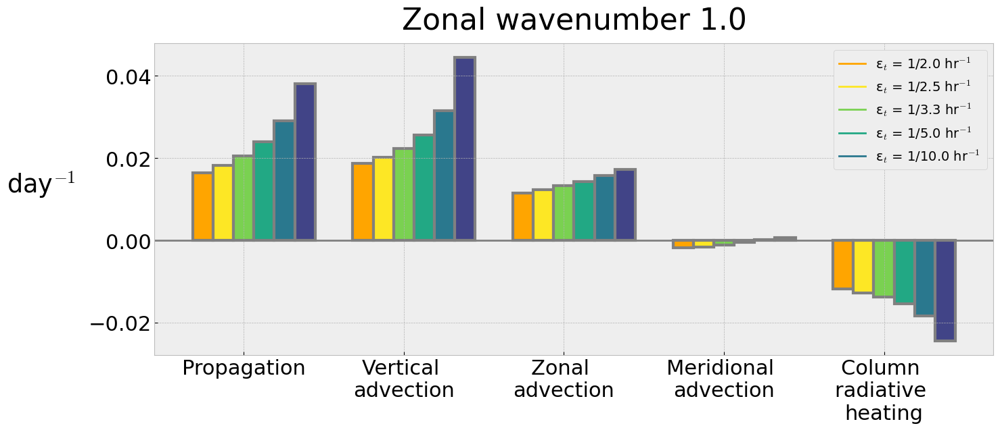

In [4214]:
plt.style.use('bmh')
plt.rcParams.update({'font.size':22})
fig = plt.figure(figsize=(16,6))
# fig = plt.figure(figsize=(20,2))
gs_main = gs.GridSpec(1, 1, figure=fig)
# gs_main.update(hspace=0.3)

bar_labels = [
    f"Propagation",
    f"Vertical \nadvection" ,
    f"Zonal \nadvection",
    f"Meridional \nadvection",
    f"Column \nradiative \nheating",
]

process_colors = {
    'growth'                   : '#ffa500', 
    'propagation'              : '#ffa500', 
    'vertical advection'       : '#1cf91a',
    'omega'                    : '#1cf91a',
    'column processes'         : '#1cf91a',
    'zonal advection'          : '#0533ff',
    'u'                        : '#0533ff',
    'meridional advection'     : '#ff40ff', 
    'v'                        : '#ff40ff', 
    'column radiative heating' : '#4e2d8c',
    'Qr'                       : '#4e2d8c',
    'diffusion'                : '#A60628',
    'residual'                 : 'gray',
}

# ax = []
ax = fig.add_subplot(gs_main[0])
# ax.set_title("Propagation across experiments", pad=10)
ax.set_title(f"Zonal wavenumber {solution_k[experiments[0]]}", pad=15)
# width = 0.1375
width = 0.125
# width = 0.3

grand_max = []
for variable in multi_experiment_propagation_budgets.data_vars:
    grand_max.append(np.abs(multi_experiment_propagation_budgets[variable].values.max()))

grand_max = np.max(grand_max)

normalized = False
width = 0.1275
multiplier = 0
bar_locations = np.arange(len(bar_labels))
bar_max = []
for exp in multi_experiment_propagation_budgets["experiment"].values:
    print(exp)
    offset = width * multiplier

    if not normalized:
        bar_values = [
                24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values,
                24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*multi_experiment_propagation_budgets['omega'].sel(experiment=exp).values,
                24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*multi_experiment_propagation_budgets['u'].sel(experiment=exp).values,
                24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*multi_experiment_propagation_budgets['v'].sel(experiment=exp).values,
                24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*multi_experiment_propagation_budgets['Qr'].sel(experiment=exp).values,
            ]
    else:
        bar_values = [
                1,
                multi_experiment_propagation_budgets['omega'].sel(experiment=exp).values,
                multi_experiment_propagation_budgets['u'].sel(experiment=exp).values,
                multi_experiment_propagation_budgets['v'].sel(experiment=exp).values,
                multi_experiment_propagation_budgets['Qr'].sel(experiment=exp).values,
            ]
    bar_max.append(np.max(bar_values))

    # if exp == experiments[0]:
    #     bar_values = [
    #         24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values,
    #         24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*multi_experiment_propagation_budgets['omega'].sel(experiment=exp).values,
    #         24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*multi_experiment_propagation_budgets['u'].sel(experiment=exp).values,
    #         24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*multi_experiment_propagation_budgets['v'].sel(experiment=exp).values,
    #         24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*multi_experiment_propagation_budgets['Qr'].sel(experiment=exp).values,
    #     ]
    #     bar_max.append(np.max(bar_values))

    # else:
    #     bar_values = [0,0,0,0,0]
    
    rects = ax.bar(
        bar_locations + offset, 
        bar_values, 
        label = exp, 
        color = colors[exp], 
        width = width,
        edgecolor='gray', 
        # edgecolor='#bcbcbc', 
        linewidth=3,
        align='center'
    )    
    # ax.bar_label(rects, padding=0.3)
    multiplier += 1
    # ax.set_ylim(-0.1, 0.15)
    

ax.axhline(y = 0, color='gray', lw=2)
ax.set_ylabel(r'day$^{-1}$', rotation=0, labelpad=50)
ax.set_xticks(bar_locations+offset/len(bar_labels)+width, labels = bar_labels)
# ax.set_yticks([-0.02, -0.01, 0, 0.01, 0.02, 0.03, 0.04])

# leg = ax.legend(handles=[leg_names[0], leg_names[-4], leg_names[-3], leg_names[-2]], ncol=1, fontsize=14, loc="upper right")
leg = ax.legend(handles=leg_names[:-1], ncol=1, fontsize=14, loc="upper right")
leg.get_frame().set_alpha(1)

plt.show()

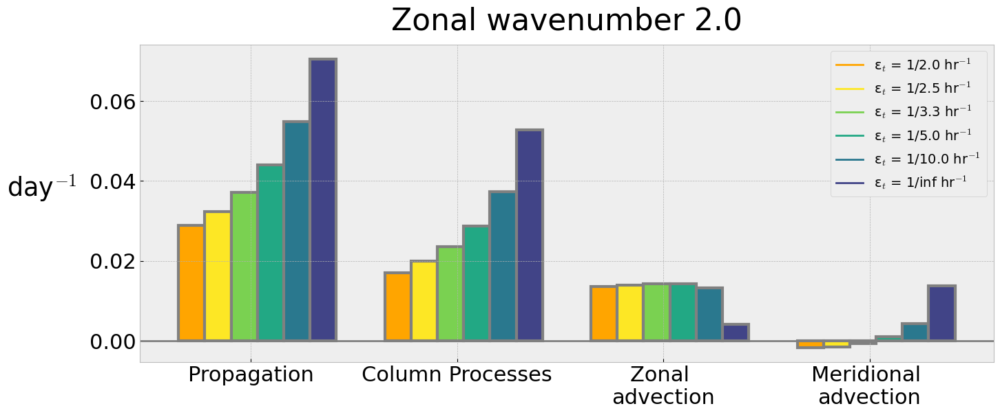

In [4165]:
plt.style.use('bmh')
plt.rcParams.update({'font.size':22})
fig = plt.figure(figsize=(16,6))
# fig = plt.figure(figsize=(20,2))
gs_main = gs.GridSpec(1, 1, figure=fig)
# gs_main.update(hspace=0.3)

bar_labels = [
    f"Propagation",
    f"Column Processes" ,
    f"Zonal \nadvection",
    f"Meridional \nadvection",
    # f"Column \nradiative \nheating",
]

process_colors = {
    'growth'                   : '#ffa500', 
    'propagation'              : '#ffa500', 
    'vertical advection'       : '#1cf91a',
    'omega'                    : '#1cf91a',
    'column processes'         : '#1cf91a',
    'zonal advection'          : '#0533ff',
    'u'                        : '#0533ff',
    'meridional advection'     : '#ff40ff', 
    'v'                        : '#ff40ff', 
    'column radiative heating' : '#4e2d8c',
    'Qr'                       : '#4e2d8c',
    'diffusion'                : '#A60628',
    'residual'                 : 'gray',
}

# ax = []
ax = fig.add_subplot(gs_main[0])
# ax.set_title("Propagation across experiments", pad=10)
ax.set_title(f"Zonal wavenumber {solution_k[experiments[0]]}", pad=15)
# width = 0.1375
width = 0.125
# width = 0.3

grand_max = []
for variable in multi_experiment_propagation_budgets.data_vars:
    grand_max.append(np.abs(multi_experiment_propagation_budgets[variable].values.max()))

grand_max = np.max(grand_max)
normalized = False

width = 0.1275
multiplier = 0
bar_locations = np.arange(len(bar_labels))
bar_max = []
for exp in multi_experiment_propagation_budgets["experiment"].values:
    # print(exp)
    offset = width * multiplier

    if not normalized:
        bar_values = [
                24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values,
                24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*(multi_experiment_propagation_budgets['omega'].sel(experiment=exp).values+multi_experiment_propagation_budgets['Qr'].sel(experiment=exp).values),
                24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*multi_experiment_propagation_budgets['u'].sel(experiment=exp).values,
                24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*multi_experiment_propagation_budgets['v'].sel(experiment=exp).values,
            ]
    else:
        bar_values = [
                1,
                (multi_experiment_propagation_budgets['omega'].sel(experiment=exp).values+multi_experiment_propagation_budgets['Qr'].sel(experiment=exp).values),
                multi_experiment_propagation_budgets['u'].sel(experiment=exp).values,
                multi_experiment_propagation_budgets['v'].sel(experiment=exp).values,
            ]
    bar_max.append(np.max(bar_values))

    # if exp == experiments[0]:
    #     bar_values = [
    #         24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values,
    #         24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*multi_experiment_propagation_budgets['omega'].sel(experiment=exp).values,
    #         24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*multi_experiment_propagation_budgets['u'].sel(experiment=exp).values,
    #         24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*multi_experiment_propagation_budgets['v'].sel(experiment=exp).values,
    #         24*multi_experiment_propagation_budgets['propagation'].sel(experiment=exp).values*multi_experiment_propagation_budgets['Qr'].sel(experiment=exp).values,
    #     ]
    #     bar_max.append(np.max(bar_values))

    # else:
    #     bar_values = [0,0,0,0,0]
    
    rects = ax.bar(
        bar_locations + offset, 
        bar_values, 
        label = exp, 
        color = colors[exp], 
        width = width,
        edgecolor='gray', 
        # edgecolor='#bcbcbc', 
        linewidth=3,
        align='center'
    )    
    # ax.bar_label(rects, padding=0.3)
    multiplier += 1
    # ax.set_ylim(-0.01, 0.075)
    

ax.axhline(y = 0, color='gray', lw=2)
ax.set_ylabel(r'day$^{-1}$', rotation=0, labelpad=50)
ax.set_xticks(bar_locations+offset/len(bar_labels)+width, labels = bar_labels)
if normalized:
    ax.set_yticks(ticks=[-0.2, 0.0, 0.2,0.4,0.6,0.8,1])#, labels=[-20, 0, 20,40,60,80,100])

# leg = ax.legend(handles=[leg_names[0], leg_names[-4], leg_names[-3], leg_names[-2]], ncol=1, fontsize=14, loc="lower right")
leg = ax.legend(handles=leg_names[:-1], ncol=1, fontsize=14, loc="upper right")
leg.get_frame().set_alpha(1)

plt.show()

## Plot horizontal structure of \<h\> tendency

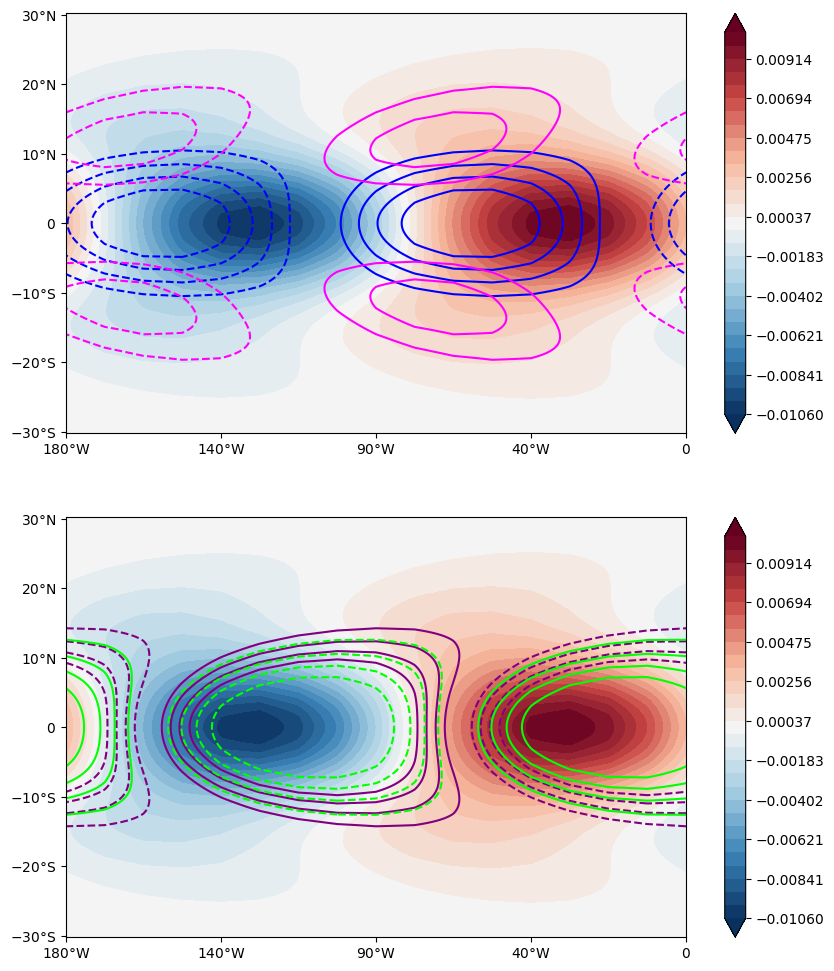

In [3020]:
exp= experiments[3]
# h = qhat[exp].values + That[exp].values
h_levels = np.linspace(-np.max(np.abs(h_tendency[exp])), np.max(np.abs(h_tendency[exp])), 30)

plt.style.use('default')
[fig, ax] = plt.subplots(2, 1, figsize=(10,12))

# Plot <h>
Ch = ax[0].contourf(
    x[exp].values*1e-3*Re[exp_name],
    y[exp].values*1e-3,
    h_tendency[exp].T, 
    cmap=Ahmed_cmap, 
    levels=h_levels, 
    extend='both'
)
cbar = plt.colorbar(Ch)
# cbar.set_ticks(np.arange(-1, 1.25, 0.25))

# Plot σ_x * u_1
ax[0].contour(
    x[exp].values*1e-3*Re[exp_name],
    y[exp].values*1e-3,
    3600/delpg*sigma_x[exp]*u[exp].T, 
    colors='blue', 
    levels=np.delete(np.linspace(-4e-3, 4e-3, 10), [4,5])
)

# Plot -σ_y * y * u_1
ax[0].contour(
    x[exp].values*1e-3*Re[exp_name],
    y[exp].values*1e-3,
    -3600/delpg*sigma_y[exp]*(y[exp].values*v[exp].values).T, 
    colors='magenta', 
    levels=np.delete(np.linspace(-4e-3, 4e-3, 10), [4,5])
)

# Format the axes
xlocs=np.arange(0,390,45)*2*np.pi*Re[exp_name]*1e-3/(360)
xmajorLocator = matplotlib.ticker.FixedLocator(locs=xlocs) 
xmajorFormatter = matplotlib.ticker.FuncFormatter(xtolon)

ax[0].xaxis.set_major_locator( xmajorLocator )
ax[0].xaxis.set_major_formatter( xmajorFormatter )
# ax[0].set_xlim(0, 180*2*np.pi*Re[exp_name]*1e-3/(360))
ax[0].set_xlim(0, 360*2*np.pi*Re[exp_name]*1e-3/(360)/solution_k[exp])


ylocs=np.arange(-30,40.0,10.0)*111
# ylocs=np.arange(-35,45.0,10.0)*111
ymajorLocator = matplotlib.ticker.FixedLocator(locs=ylocs) 
ymajorFormatter = matplotlib.ticker.FuncFormatter(ytolat)

ax[0].yaxis.set_major_locator( ymajorLocator )
ax[0].yaxis.set_major_formatter( ymajorFormatter )
ax[0].set_ylim(-30.25*111, 30.25*111)

ax[0].set_aspect('auto')


#### Second plot
# Plot <h>
Ch = ax[1].contourf(
    x[exp].values*1e-3*Re[exp_name],
    y[exp].values*1e-3,
    h_tendency[exp].T, 
    cmap=Ahmed_cmap, 
    levels=h_levels, 
    extend='both'
)
cbar = plt.colorbar(Ch)
# cbar.set_ticks(np.arange(-1, 1.25, 0.25))

# Plot <Qr>
ax[1].contour(
    x[exp].values*1e-3*Re[exp_name],
    y[exp].values*1e-3,
    3600*(epsq[exp]*qhat[exp].values - epst[exp]*That[exp].values).T, 
    colors='purple', 
    levels=np.delete(np.linspace(-3e-2, 3e-2, 10), [4,5])
)

# Plot m * Ms * ω_1
ax[1].contour(
    x[exp].values*1e-3*Re[exp_name],
    y[exp].values*1e-3,
    3600/delpg*(0.25*Ms[exp]*omega[exp].T), 
    colors='lime', 
    levels=np.delete(np.linspace(-1.4e-2, 1.4e-2, 10), [4,5])
)

# Format axes
xlocs=np.arange(0,390,45)*2*np.pi*Re[exp_name]*1e-3/(360)
xmajorLocator = matplotlib.ticker.FixedLocator(locs=xlocs) 
xmajorFormatter = matplotlib.ticker.FuncFormatter(xtolon)

ax[1].xaxis.set_major_locator( xmajorLocator )
ax[1].xaxis.set_major_formatter( xmajorFormatter )
ax[1].set_xlim(0, 360*2*np.pi*Re[exp_name]*1e-3/(360)/solution_k[exp])

ylocs=np.arange(-30,40.0,10.0)*111
# ylocs=np.arange(-35,45.0,10.0)*111
ymajorLocator = matplotlib.ticker.FixedLocator(locs=ylocs) 
ymajorFormatter = matplotlib.ticker.FuncFormatter(ytolat)

ax[1].yaxis.set_major_locator( ymajorLocator )
ax[1].yaxis.set_major_formatter( ymajorFormatter )
ax[1].set_ylim(-30.25*111, 30.25*111)

ax[1].set_aspect('auto')

## Moisture Growth Budget

In [3599]:
multi_experiment_moisture_growth_budgets = xr.Dataset(
    data_vars=dict(
        growth=(["experiment"], np.empty((len(experiments)))),
        omega=(["experiment"], np.empty((len(experiments)))),
        u=(["experiment"], np.empty((len(experiments)))),
        v=(["experiment"], np.empty((len(experiments)))),
        P=(["experiment"], np.empty((len(experiments)))),
), 
    coords=dict(
        experiment=experiments,
    ), 
)

for exp_index, exp_name in enumerate(experiments):
# exp_name = experiments[1]
    
    budget_u = u[exp_name].values
    budget_v = v[exp_name].values
    budget_y = y[exp_name].values
    budget_omega = omega[exp_name].values
    budget_q = qhat[exp_name].values
    budget_T = That[exp_name].values
    budget_precip = (epsq[exp_name]*budget_q - epst[exp_name]*budget_T)
    
    # h = budget_q + budget_T
    budget_region = np.where(np.abs(budget_y)/METERS_PER_DEGREE <= 45)[0]
    # budget_region = np.where((budget_y/METERS_PER_DEGREE >= 10)*(budget_y/METERS_PER_DEGREE <= 30))[0]
    
    near_equatorial_u = budget_u[:, budget_region]
    near_equatorial_v = budget_v[:, budget_region]
    near_equatorial_y = budget_y[budget_region]
    near_equatorial_omega = budget_omega[:, budget_region]
    near_equatorial_q = budget_q[:, budget_region]
    near_equatorial_T = budget_T[:, budget_region]
    near_equatorial_precip = budget_precip[:, budget_region]
    
    wv_index = np.abs(klist_read - solution_k[exp_name]).argmin()
    growth_value = (disp_growthm[exp_name][wv_index])[~np.isnan(disp_growthm[exp_name][wv_index])].squeeze()
    if (solution_k[exp_name] == 1.0) and (epst[exp_name] == 0):
        growth_value = (disp_growthp[exp_name][wv_index])[2].squeeze()

    # elif (solution_k[exp_name] == 3.0) and (epst[exp_name] == 0):
    #     growth_value = (disp_growthp[exp_name][wv_index])[~np.isnan(disp_growthp[exp_name][wv_index])].squeeze()
    
    omega_term = -3600*(0.75*Ms[exp_name])/delpg*near_equatorial_omega
    omega_contribution = calculate_budget(omega_term, near_equatorial_q)
    
    u_term = 3600*sigma_x[exp_name]/delpg*near_equatorial_u
    u_contribution = calculate_budget(u_term, near_equatorial_q)
    
    v_term = -3600*sigma_y[exp_name]/delpg*near_equatorial_y*near_equatorial_v
    v_contribution = calculate_budget(v_term, near_equatorial_q)

    precipitation_term = -3600*near_equatorial_precip
    precipitation_contribution = calculate_budget(precipitation_term, near_equatorial_q)

    multi_experiment_moisture_growth_budgets['growth'][exp_index] = growth_value
    multi_experiment_moisture_growth_budgets['omega'][exp_index] = omega_contribution
    multi_experiment_moisture_growth_budgets['u'][exp_index] = u_contribution
    multi_experiment_moisture_growth_budgets['v'][exp_index] = v_contribution
    multi_experiment_moisture_growth_budgets['P'][exp_index] = precipitation_contribution

meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=7.70_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=8.50_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=9.60_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=11.00_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.100_cp=14.00_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.000_cp=18.00_k=1.00_model=A


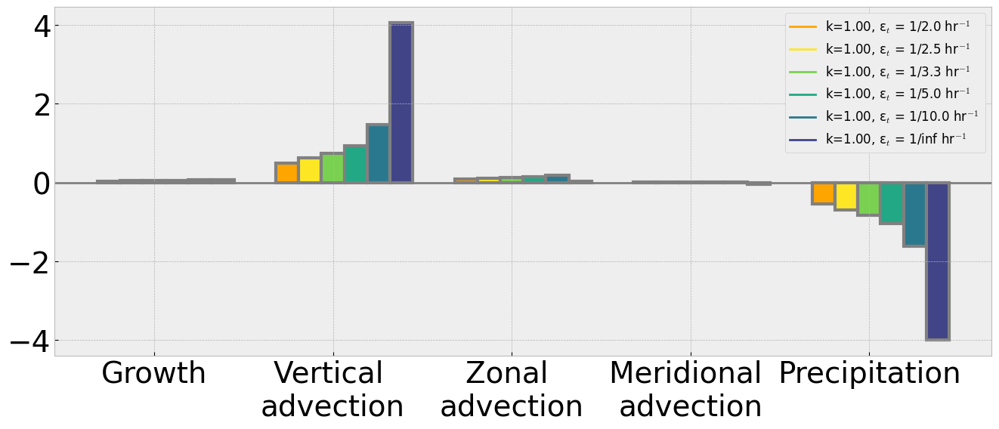

In [3600]:
plt.style.use('bmh')
fig = plt.figure(figsize=(16,6))
# fig = plt.figure(figsize=(16,3))
gs_main = gs.GridSpec(1, 1, figure=fig)
# gs_main.update(hspace=0.3)

bar_labels = [
    f"Growth",
    f"Vertical \nadvection" ,
    f"Zonal \nadvection",
    f"Meridional \nadvection",
    f"Precipitation",
]

process_colors = {
    'growth'                   : '#ffa500', 
    'propagation'              : '#ffa500', 
    'vertical advection'       : '#1cf91a',
    'omega'                    : '#1cf91a',
    'column processes'         : '#1cf91a',
    'zonal advection'          : '#0533ff',
    'u'                        : '#0533ff',
    'meridional advection'     : '#ff40ff', 
    'v'                        : '#ff40ff', 
    'column radiative heating' : '#4e2d8c',
    'Qr'                       : '#4e2d8c',
    'diffusion'                : '#A60628',
    'residual'                 : 'gray',
}

# ax = []
ax = fig.add_subplot(gs_main[0])
# ax.set_title(f"Zonal wavenumber {solution_k[experiments[0]]}", pad=15)
# width = 0.1375
width = 0.125
# width = 0.3

grand_max = []
grand_min = []
for variable in multi_experiment_moisture_growth_budgets.data_vars:
    grand_max.append(24*multi_experiment_moisture_growth_budgets[variable].values.max())
    grand_min.append(24*multi_experiment_moisture_growth_budgets[variable].values.min())

grand_max = np.max(grand_max)
grand_min = np.min(grand_min)

width = 0.1275
multiplier = 0
bar_locations = np.arange(len(bar_labels))
bar_max = []
for exp in multi_experiment_moisture_growth_budgets["experiment"].values:
    print(exp)
    offset = width * multiplier
    # if exp == experiments[0]:
    bar_values = [
            24*multi_experiment_moisture_growth_budgets['growth'].sel(experiment=exp),
            24*multi_experiment_moisture_growth_budgets['omega'].sel(experiment=exp),
            24*multi_experiment_moisture_growth_budgets['u'].sel(experiment=exp),
            24*multi_experiment_moisture_growth_budgets['v'].sel(experiment=exp),
            24*multi_experiment_moisture_growth_budgets['P'].sel(experiment=exp),
        ]
    bar_max.append(np.max(bar_values))

    rects = ax.bar(
        bar_locations + offset, 
        bar_values, 
        label = exp, 
        color = colors[exp], 
        width = width,
        edgecolor='gray', 
        # edgecolor='#bcbcbc', 
        linewidth=3,
        align='center'
    )    
    # ax.bar_label(rects, padding=0.3)
    multiplier += 1

    # ax.set_ylim(-1.05*max(np.abs(grand_min), np.abs(grand_max)), 1.05*max(np.abs(grand_min), np.abs(grand_max)))

ax.axhline(y = 0, color='gray', lw=2)
# ax.set_ylabel(r'day$^{-1}$', rotation=0, labelpad=30)
ax.set_xticks(bar_locations+offset/len(bar_labels)+width, labels = bar_labels)

leg = ax.legend(handles=[leg_names[0], leg_names[-4], leg_names[-3], leg_names[-2]], ncol=1, fontsize=12, loc="lower right")
leg = ax.legend(handles=leg_names[:-1], ncol=1, fontsize=12, loc="best")
leg.get_frame().set_alpha(1)

plt.show()

meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.500_cp=7.70_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.400_cp=8.50_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.300_cp=9.60_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.200_cp=11.00_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.100_cp=14.00_k=1.00_model=A
meff=0.10_xiy=1.00_xix=1.00_epsq=0.167_epst=0.000_cp=18.00_k=1.00_model=A


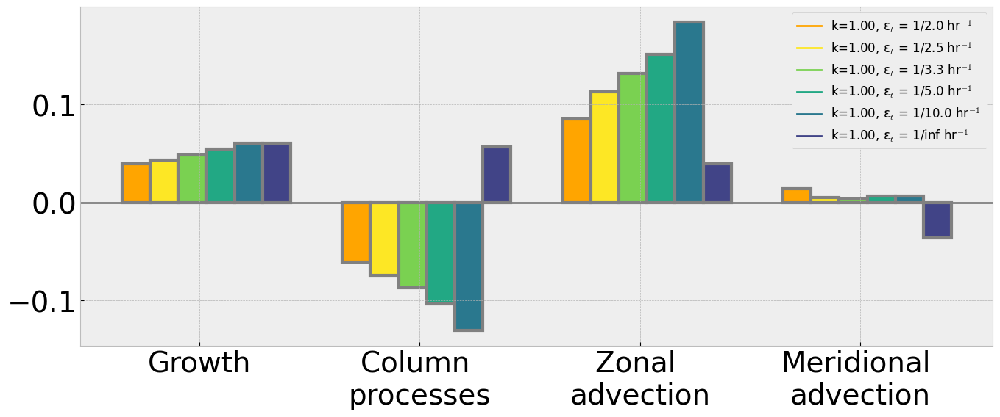

In [3601]:
plt.style.use('bmh')
fig = plt.figure(figsize=(16,6))
# fig = plt.figure(figsize=(16,3))
gs_main = gs.GridSpec(1, 1, figure=fig)
# gs_main.update(hspace=0.3)

bar_labels = [
    f"Growth",
    f"Column \nprocesses" ,
    f"Zonal \nadvection",
    f"Meridional \nadvection",
    # f"Precipitation",
]

process_colors = {
    'growth'                   : '#ffa500', 
    'propagation'              : '#ffa500', 
    'vertical advection'       : '#1cf91a',
    'omega'                    : '#1cf91a',
    'column processes'         : '#1cf91a',
    'zonal advection'          : '#0533ff',
    'u'                        : '#0533ff',
    'meridional advection'     : '#ff40ff', 
    'v'                        : '#ff40ff', 
    'column radiative heating' : '#4e2d8c',
    'Qr'                       : '#4e2d8c',
    'diffusion'                : '#A60628',
    'residual'                 : 'gray',
}

# ax = []
ax = fig.add_subplot(gs_main[0])
# ax.set_title(f"Zonal wavenumber {solution_k[experiments[0]]}", pad=15)
# width = 0.1375
width = 0.125
# width = 0.3

grand_max = []
grand_min = []
for variable in multi_experiment_moisture_growth_budgets.data_vars:
    grand_max.append(24*multi_experiment_moisture_growth_budgets[variable].values.max())
    grand_min.append(24*multi_experiment_moisture_growth_budgets[variable].values.min())

grand_max = np.max(grand_max)
grand_min = np.min(grand_min)

width = 0.1275
multiplier = 0
bar_locations = np.arange(len(bar_labels))
bar_max = []
for exp in multi_experiment_moisture_growth_budgets["experiment"].values:
    print(exp)
    offset = width * multiplier
    # if exp == experiments[0]:
    bar_values = [
            24*multi_experiment_moisture_growth_budgets['growth'].sel(experiment=exp),
            24*(multi_experiment_moisture_growth_budgets['omega'].sel(experiment=exp)+multi_experiment_moisture_growth_budgets['P'].sel(experiment=exp)),
            24*multi_experiment_moisture_growth_budgets['u'].sel(experiment=exp),
            24*multi_experiment_moisture_growth_budgets['v'].sel(experiment=exp),
            
    ]
    bar_max.append(np.max(bar_values))

    rects = ax.bar(
        bar_locations + offset, 
        bar_values, 
        label = exp, 
        color = colors[exp], 
        width = width,
        edgecolor='gray', 
        # edgecolor='#bcbcbc', 
        linewidth=3,
        align='center'
    )    
    # ax.bar_label(rects, padding=0.3)
    multiplier += 1

    # ax.set_ylim(-1.05*max(np.abs(grand_min), np.abs(grand_max)), 1.05*max(np.abs(grand_min), np.abs(grand_max)))

ax.axhline(y = 0, color='gray', lw=2)
# ax.set_ylabel(r'day$^{-1}$', rotation=0, labelpad=30)
ax.set_xticks(bar_locations+offset/len(bar_labels)+width, labels = bar_labels)

leg = ax.legend(handles=[leg_names[0], leg_names[-4], leg_names[-3], leg_names[-2]], ncol=1, fontsize=12, loc="lower right")
leg = ax.legend(handles=leg_names[:-1], ncol=1, fontsize=12, loc="best")
leg.get_frame().set_alpha(1)

plt.show()

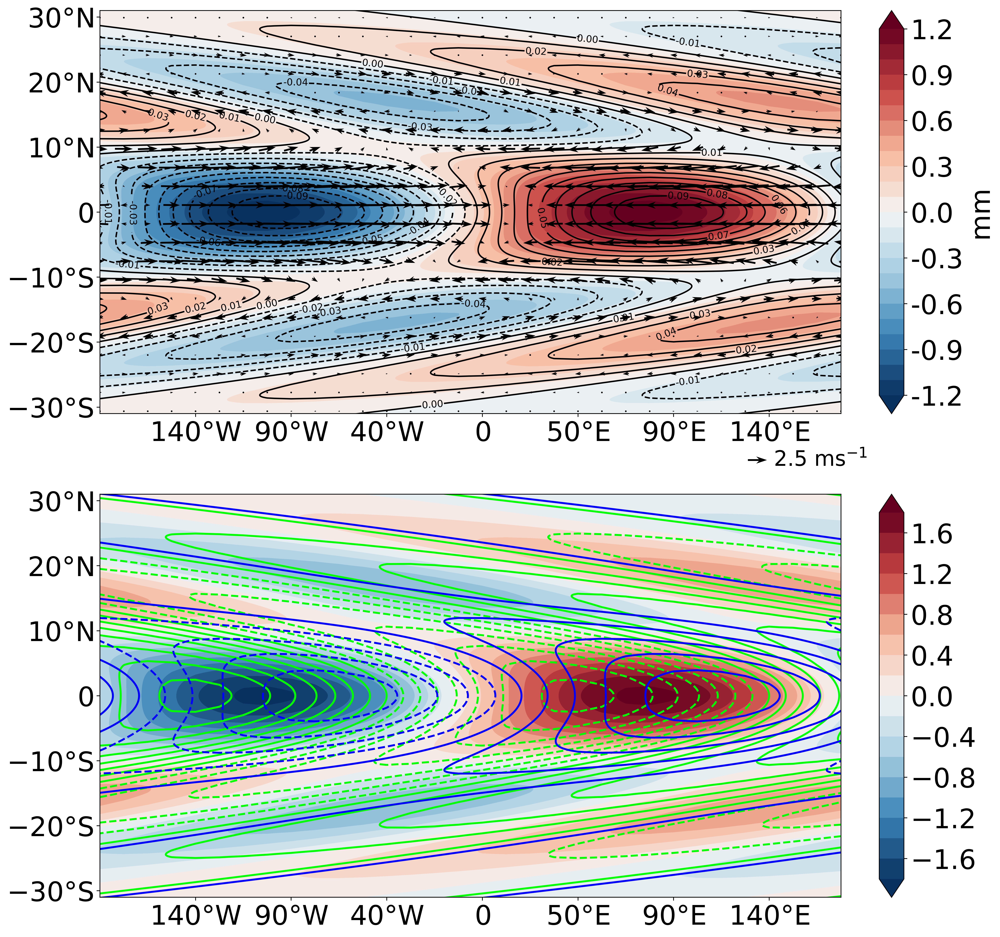

In [3606]:
plt.style.use('default')
plt.rcParams.update({'font.size':28})

# scale=5/u[exp_name].values.max()  # scale structures such that max zonal wind is 5 m/s
# scale=1/(qhat[exp_name].values.max()*delpg*cp/Lv)  # scale structures such that max moisture anomaly is 1 mm

exp_name = experiments[0]

scale=0.1/(That[exp_name].values.max())  # scale structures such that max zonal wind is 5 m/s
u_norm=-np.copy(u[exp_name]*scale)
v_norm=-np.copy(v[exp_name]*scale)
# u_norm[:]=0.0
xarr=x[exp_name]*Re[exp_name]*1e-6
yarr=y[exp_name]*1e-6
xiint=1
# yiint=32
yiint=32

moisture_x_max = np.argmax(That[exp_name].values[:, 1001//2])

if solution_k[exp_name] == 1:
    shifted_location = int(3*len(x[exp_name])/4)
elif solution_k[exp_name] == 2:
    shifted_location = int(7*len(x[exp_name])/8)
elif solution_k[exp_name] == 3:
    shifted_location = int(7*len(x[exp_name])/8)
# shifted_location = 28
roll = shifted_location - moisture_x_max

rolled_That = np.roll(That[exp_name], axis=0, shift=roll)
rolled_qhat = np.roll(qhat[exp_name], axis=0, shift=roll)
rolled_u = np.roll(u_norm, axis=0, shift=roll)
rolled_v = np.roll(v_norm, axis=0, shift=roll)

X, Y = np.meshgrid(xarr, yarr, indexing='ij')

pcp_scale=24*delpg*cp/Lv ## convert to mm/d

# scale_vec=0.0025*0.25
# scale_vec=0.0025*0.5
# quiverkey_length=5.00/3e2

fig = plt.figure(figsize=(14.5, 16.0), dpi=500)
gs_main = gs.GridSpec(2, 2, height_ratios = [1,1], width_ratios=[30,1], figure=fig)

# Update the bounds and spacing of the gs.GridSpec
gs_main.update(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.1)

# Add an axis for the initial condition
ax = []
ax.append(fig.add_subplot(gs_main[0,0]))
ax.append(fig.add_subplot(gs_main[1,0]))

cbar_ax = []
cbar_ax.append(fig.add_subplot(gs_main[0,1]))
cbar_ax.append(fig.add_subplot(gs_main[1,1]))
CS=ax[0].contour(
    xarr,
    yarr,
    # rolled_x,
    # rolled_y,
    # That[exp_name].T*scale,
    rolled_That.T*scale,
    # levels=that_range*scale,
    # levels=15,
    levels=np.linspace(-0.1, 0.1, 21),
    colors='black'
)
ax[0].clabel(CS, CS.levels, inline=True, fmt='%.2f', fontsize=10)

CT = ax[0].contourf(
    xarr,
    yarr,
    # rolled_x,
    # rolled_y,
    rolled_qhat.T*scale*delpg*cp/Lv,
    # levels=qhat_range*scale*0.5,
    # levels=np.linspace(-1,1,30),
    levels=30,
    extend='both',
    cmap=Ahmed_cmap
)

CB=plt.colorbar(
    CT, 
    cax=cbar_ax[0],
    label='mm',
    orientation='vertical',
    format="%.1f",
    # ticks=matplotlib.ticker.MultipleLocator(0.2))
)

vector_scale = 2.5
key_length = 1
q=ax[0].quiver(
    X[::xiint,::yiint],
    Y[::xiint,::yiint],
    rolled_u[::xiint,::yiint],
    rolled_v[::xiint,::yiint],
    angles='xy',
    scale_units='xy',
    units='xy',
    scale=vector_scale,
    pivot='middle',
    # pivot='tail',
    alpha=1.0,
    color='black',
    headwidth=4,
    headlength=6,
    headaxislength=4.5,
    zorder=10
)


ax[0].quiverkey(
    q, 
    X=0.9,
    # Y=1.025,
    Y=-0.115,
    U=vector_scale*key_length,
    label=f"{vector_scale*key_length}" + r' $\mathrm{ms}^{-1}$',
    labelpos='E',
    color='black',
    fontproperties={'size': '22'},
    coordinates='axes'
)

#### Second plot
# Plot <h>
Cq = ax[1].contourf(
    xarr,
    yarr,
    # np.roll(h[exp_name].T, axis=0, shift=roll), 
    np.roll(
        qhat[exp_name], 
        axis=0, 
        shift=roll
    ).T, 
    cmap=Ahmed_cmap, 
    levels=21,
    # levels=np.linspace(-1, 1, 21),
    extend='both'
)
cbar = plt.colorbar(Cq, cax=cbar_ax[1], orientation='vertical')
# cbar.set_ticks(np.arange(-1, 1.25, 0.25))

# Plot P
# CQr = ax[1].contour(
#     xarr,
#     yarr,
#     np.roll(
#         -3600*(epsq[exp_name]*qhat[exp_name].values - epst[exp_name]*That[exp_name].values), 
#         axis=0, 
#         shift=roll
#     ).T, 
#     colors='purple', 
#     # levels=np.delete(np.linspace(-3e-2, 3e-2, 10), [4,5]),
#     levels=15,
#     linewidths=2
# )
# ax[1].clabel(CQr, CQr.levels, inline=True, fmt='%.e', fontsize=10)

# Plot m * Ms * ω_1
COmega = ax[1].contour(
    xarr,
    yarr,
    np.roll(
        (
            -3600*(epsq[exp_name]*qhat[exp_name].values - epst[exp_name]*That[exp_name].values)
            -3600/delpg*(0.75*Ms[exp_name]*omega[exp_name])
        ), 
        axis=0, 
        shift=roll
    ).T, 
    colors='lime', 
    # levels=np.delete(np.linspace(-1.4e-2, 1.4e-2, 10), [4,5]),
    levels=15,
    linewidths=2
)
# ax[1].clabel(COmega, COmega.levels, inline=True, fmt='%.2e', fontsize=10)

# Plot σ_x * u
ax[1].contour(
    xarr,
    yarr,
    np.roll(
        3600/delpg*sigma_x[exp_name]*u[exp_name].values,
        axis=0,
        shift=roll
    ).T, 
    colors='blue', 
    # levels=np.delete(np.linspace(-1.4e-2, 1.4e-2, 10), [4,5]),
    levels=11,
    linewidths=2
)
 
# Format axes
for index, _ in enumerate(ax):
    
    ax[index].tick_params(which='both')
    # ax[index].set_xlim([19.47787445, 38.9557489])
    # xlocs=np.arange(180,390,30)*2*np.pi*Re[exp_name]*1e-6/(360)
    if solution_k[exp_name] == 1:
        ax[index].set_xlim([0, 38.9557489])
        xlocs=np.arange(45,390,45)*2*np.pi*Re[exp_name]*1e-6/(360)
    elif solution_k[exp_name] == 2:
        ax[index].set_xlim([38.9557489/2, 38.9557489])
        xlocs=np.arange(180,390,30)*2*np.pi*Re[exp_name]*1e-6/(360)
    elif solution_k[exp_name] == 3:
        ax[index].set_xlim([2*38.9557489/3, 38.9557489])
        xlocs=np.arange(240,390,30)*2*np.pi*Re[exp_name]*1e-6/(360)
    xmajorLocator = matplotlib.ticker.FixedLocator(locs=xlocs) 
    xmajorFormatter = matplotlib.ticker.FuncFormatter(xtolon)
    
    ax[index].xaxis.set_major_locator( xmajorLocator )
    ax[index].xaxis.set_major_formatter( xmajorFormatter )
    
    ax[index].set_ylim(-31*111e-3,31*111e-3)
    # ax[index].set_ylim(10*111e-3,31*111e-3)
    ylocs=np.arange(-40,50.0,10.0)*111e-3
    # ylocs=np.arange(-40,50.0,5.0)*111e-3
    ymajorLocator = matplotlib.ticker.FixedLocator(locs=ylocs) 
    ymajorFormatter = matplotlib.ticker.FuncFormatter(ytolat)
    
    ax[index].yaxis.set_major_locator( ymajorLocator )
    ax[index].yaxis.set_major_formatter( ymajorFormatter )
    
    ax[index].set_aspect('auto')

plt.show()
# plt.savefig(
#     (
#         f"./figures/model_{model_type[exp_name]}_k={solution_k[exp_name]:0.2f}"
#         + f"_epsq={epsq[exp_name]*3600:0.3f}_epst={epst[exp_name]*3600:0.3f}"
#         + f"_joint-horizontal-structure-and-budget-terms.png"
#     ), 
#     bbox_inches='tight',
#     dpi=350
# )

/tmp/ipykernel_2563720/4275593963.py:15: RuntimeWarning: divide by zero encountered in scalar divide
  label=r"ε$_t$ = 1/" + f"{1/(3600*epst[exp_name]):0.1f}" + r" hr$^{-1}$ "


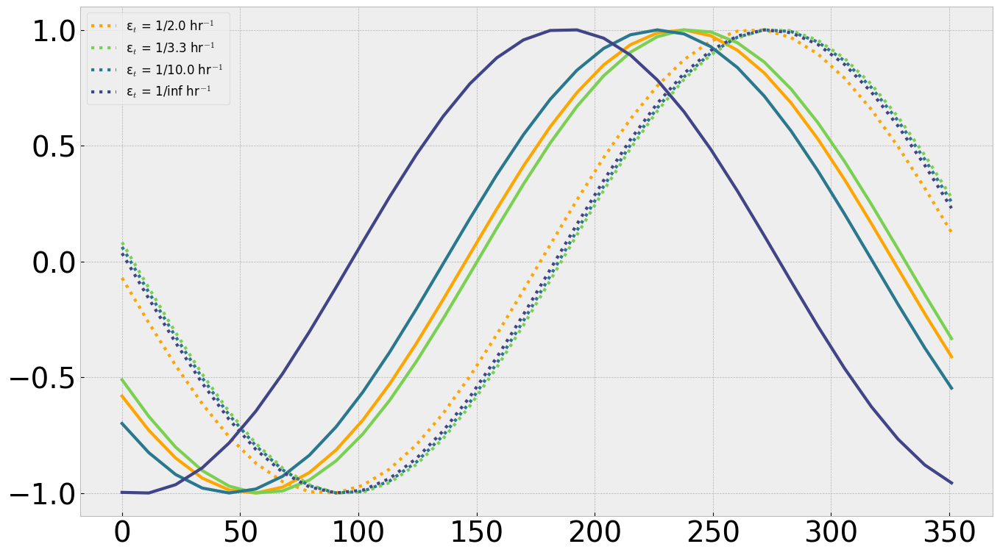

In [3648]:
plt.style.use('bmh')
[fig, ax] = plt.subplots(1, 1, figsize=(16,9))
# for index,exp_name in enumerate(experiments[::2]):
for index,exp_name in enumerate([experiments[0], experiments[2], experiments[-2], experiments[-1]]):
    equatorial_u = u[exp_name].values[:, 1001//2]
    equatorial_q = qhat[exp_name].values[:, 1001//2]
    x_max = np.argmax(equatorial_u) - int(3*len(xarr)/4)
    
    ax.plot(
        xarr/111e-3,
        np.roll(equatorial_u, shift=-x_max)/np.max(equatorial_u), 
        color=colors[exp_name], 
        ls=':', 
        lw=3,
        label=r"ε$_t$ = 1/" + f"{1/(3600*epst[exp_name]):0.1f}" + r" hr$^{-1}$ "
    )
    
    ax.plot(
        xarr/111e-3,
        np.roll(equatorial_q, shift=-x_max)/np.max(equatorial_q),
        color=colors[exp_name], 
        ls='-', 
        lw=3
    )
ax.legend(loc='best', fontsize=12)
plt.show()

# Plot numerical solutions

In [2788]:
# exp_name = experiments[1]

# GRAVITY = 9.81                           # g [m/s^2]
# EQUIVALENT_DEPTH = 250.                  # H [m]
# CORIOLIS_PARAMETER = 2.29e-11            # ß [m^-1 s^-1]
# EARTH_RADIUS = 6371.0072e3               # R_e [m]
# AIR_DENSITY = 1.225                      # ρ_a [kg m^-3]
# WATER_DENSITY = 997                      # ρ_w [kg m^-3]
# LATENT_HEAT = 2260000                    # L_v [J kg^-1 K^-1]
# SPECIFIC_HEAT = 1004                     # c_p [J kg^-1]

# METERS_PER_DEGREE = 2*np.pi*EARTH_RADIUS/360
# # METERS_PER_DEGREE = 55e3
# SECONDS_PER_DAY = 86400
# COLUMN_AVERAGE_MASS = 1000*100/9.81

# grid_scaling = 1e-6
# save_timestamp = False

# physical_parameters = (
#     SPECIFIC_HEAT, 
#     LATENT_HEAT,
#     WATER_DENSITY,
#     COLUMN_AVERAGE_MASS,
#     EARTH_RADIUS,
#     METERS_PER_DEGREE,
#     SECONDS_PER_DAY,
# )

# u_array = np.broadcast_to(u_norm.T, (1, 1001, 33))
# v_array = np.broadcast_to(v_norm.T, (1, 1001, 33))
# T_array = np.broadcast_to(That[exp_name].values.T, (1, 1001, 33))
# q_array = np.broadcast_to(qhat[exp_name].values.T, (1, 1001, 33))

# u_scaled = 1*u_array/np.max(np.abs(q_array))
# v_scaled = 1*v_array/np.max(np.abs(q_array))
# T_scaled = 1*T_array/np.max(np.abs(q_array))
# q_scaled = 1*q_array/np.max(np.abs(q_array))

# [argy, argx] = np.unravel_index(np.argmax(q_array[0]), [1001, 33])
# shift_value = -argx + 33//2

# # k=2

# plotting_parameters = (
#     (0, 120),               # xlims
#     # (0, 360),               # xlims
#     # (-60, -60+180),
#     # (-35, 35),                 # ylims 
#     (-31.53153153153153, 31.53153153153153),
#     # (-60, 60),                 # ylims 
#     10,14,                      # quiver plot spacing (x,y)
#     False,                     # save plot to png
#     'converted',               # plotting units - 'converted' or 'natural'
#     # 0.6,                       # maximum moisture anomaly in 'mm' - must be set to '1' if units are 'natural'
#     # 'natural',               # plotting units - 'converted' or 'natural'
#     1,                       # maximum moisture anomaly in 'mm' - must be set to '1' if units are 'natural'
#     grid_scaling,               # grid-scaling factor - DON'T CHANGE,
#     save_timestamp             # Whether or not to timestamp the output file
# )

# # Plot the initial conditon below
# plot_horizontal_structure(
#     # day_to_index(190),
#     0,
#     xarr.values*1000,
#     yarr.values*1000,
#     np.array([0]),
#     # zonal_velocity = np.roll(-u_array/scale, shift=shift_value, axis=2), 
#     # meridional_velocity = np.roll(-v_array/scale, shift=shift_value, axis=2), 
#     # column_temperature = np.roll(T_array, shift=shift_value, axis=2), 
#     # column_moisture = np.roll(q_array, shift=shift_value, axis=2), 
#     zonal_velocity = u_array/scale, 
#     meridional_velocity = v_array/scale, 
#     column_temperature = T_array, 
#     column_moisture = q_array, 
#     specified_output_file_directory = '/home/disk/eos7/sressel/research/thesis-work/python/recreating_Ahmed21/',
#     specified_initial_condition_name = 'Ahmed-21',
#     physical_parameters = physical_parameters,
#     simulation_parameters = (True, False, 30, 0),
#     plotting_parameters = plotting_parameters
# )